# Loading Data

In [0]:
from google.colab import files
uploads=files.upload()

Saving CleanedText to CleanedText


In [0]:
df3=pd

In [0]:
!ls -lha kaggle.json

In [0]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/

In [0]:
!chmod 600 ~/.kaggle/kaggle.json

In [0]:
!pip install kaggle

In [0]:
!kaggle datasets download -d snap/amazon-fine-food-reviews
#!kaggle competitions download -c tgs-salt-identification-challenge

100% 250M/251M [00:03<00:00, 55.4MB/s]
100% 251M/251M [00:03<00:00, 68.8MB/s]


In [0]:
import zipfile
zip_ref = zipfile.ZipFile("amazon-fine-food-reviews.zip", 'r')
zip_ref.extractall("amazon")
zip_ref.close()

In [0]:
!pip install gensim

    100% |████████████████████████████████| 23.6MB 1.5MB/s 
    100% |████████████████████████████████| 1.4MB 15.2MB/s 
    100% |████████████████████████████████| 133kB 29.5MB/s 
    100% |████████████████████████████████| 4.9MB 6.8MB/s 
    100% |████████████████████████████████| 61kB 21.0MB/s 
    100% |████████████████████████████████| 552kB 11.0MB/s 
  Running setup.py bdist_wheel for smart-open ... - done
  Stored in directory: /root/.cache/pip/wheels/23/00/44/e5b939f7a80c04e32297dbd6d96fa3065af89ecf57e2b5f89f
  Running setup.py bdist_wheel for bz2file ... - done
  Stored in directory: /root/.cache/pip/wheels/81/75/d6/e1317bf09bf1af5a30befc2a007869fa6e1f516b8f7c591cb9
Successfully built smart-open bz2file


In [0]:
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")

import sqlite3

import pandas as pd
import numpy as np
import nltk
import string
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.feature_extraction.text import TfidfVectorizer

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from sklearn.metrics import roc_curve, auc
from nltk.stem.porter import PorterStemmer

import re
# Tutorial about Python regular expressions: https://pymotw.com/2/re/
import string
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.stem.wordnet import WordNetLemmatizer

from gensim.models import Word2Vec
from gensim.models import KeyedVectors
import pickle






#Data Preprocessing

In [0]:
con = sqlite3.connect('amazon/database.sqlite')

In [0]:
filtered_data = pd.read_sql_query(""" SELECT * FROM Reviews WHERE Score != 3 """, con)

In [0]:
def partition(x):
    if x < 3:
        return 'negative'
    return 'positive'

In [0]:
actualScore = filtered_data['Score']
positiveNegative = actualScore.map(partition) 
filtered_data['Score'] = positiveNegative

In [0]:
print(filtered_data.shape) #looking at the number of attributes and size of the data
filtered_data.head()

(525814, 10)


,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,positive,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,negative,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,positive,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,negative,1307923200,Cough Medicine,If you are looking for the secret ingredient i...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,positive,1350777600,Great taffy,Great taffy at a great price. There was a wid...


In [0]:
display= pd.read_sql_query("""
SELECT *
FROM Reviews
WHERE Score != 3 AND UserId="AR5J8UI46CURR"
ORDER BY ProductID
""", con)
display.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,78445,B000HDL1RQ,AR5J8UI46CURR,Geetha Krishnan,2,2,5,1199577600,LOACKER QUADRATINI VANILLA WAFERS,DELICIOUS WAFERS. I FIND THAT EUROPEAN WAFERS ...
1,138317,B000HDOPYC,AR5J8UI46CURR,Geetha Krishnan,2,2,5,1199577600,LOACKER QUADRATINI VANILLA WAFERS,DELICIOUS WAFERS. I FIND THAT EUROPEAN WAFERS ...
2,138277,B000HDOPYM,AR5J8UI46CURR,Geetha Krishnan,2,2,5,1199577600,LOACKER QUADRATINI VANILLA WAFERS,DELICIOUS WAFERS. I FIND THAT EUROPEAN WAFERS ...
3,73791,B000HDOPZG,AR5J8UI46CURR,Geetha Krishnan,2,2,5,1199577600,LOACKER QUADRATINI VANILLA WAFERS,DELICIOUS WAFERS. I FIND THAT EUROPEAN WAFERS ...
4,155049,B000PAQ75C,AR5J8UI46CURR,Geetha Krishnan,2,2,5,1199577600,LOACKER QUADRATINI VANILLA WAFERS,DELICIOUS WAFERS. I FIND THAT EUROPEAN WAFERS ...


In [0]:
uploads=files.upload()

In [0]:
sorted_data=filtered_data.sort_values('ProductId', axis=0, ascending=True, inplace=False, kind='quicksort', na_position='last')

In [0]:
final=sorted_data.drop_duplicates(subset={"UserId","ProfileName","Time","Text"}, keep='first', inplace=False)
final.shape

(364173, 10)

In [0]:
(final['Id'].size*1.0)/(filtered_data['Id'].size*1.0)*100

69.25890143662969

In [0]:

display= pd.read_sql_query("""
SELECT *
FROM Reviews
WHERE Score != 3 AND Id=44737 OR Id=64422
ORDER BY ProductID
""", con)

display.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,64422,B000MIDROQ,A161DK06JJMCYF,"J. E. Stephens ""Jeanne""",3,1,5,1224892800,Bought This for My Son at College,My son loves spaghetti so I didn't hesitate or...
1,44737,B001EQ55RW,A2V0I904FH7ABY,Ram,3,2,4,1212883200,Pure cocoa taste with crunchy almonds inside,It was almost a 'love at first bite' - the per...


In [0]:
final=final[final.HelpfulnessNumerator<=final.HelpfulnessDenominator]

In [0]:
final['Score'].value_counts()

positive    307061
negative     57110
Name: Score, dtype: int64

In [0]:
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [0]:
stop = set(stopwords.words('english'))
sno = nltk.stem.SnowballStemmer('english')

def cleanhtml(sentence): 
    cleanr = re.compile('<.*?>')
    cleantext = re.sub(cleanr, ' ', sentence)
    return cleantext
def cleanpunc(sentence):
    cleaned = re.sub(r'[?|!|\'|"|#]',r'',sentence)
    cleaned = re.sub(r'[.|,|)|(|\|/]',r' ',cleaned)
    return  cleaned


In [0]:
final.sort_values(by='Time',inplace=True)

In [0]:
i=0
str1=' '
final_string=[]
all_positive_words=[]
all_negative_words=[]
s=''
for sent in final['Text'].values:
    filtered_sentence=[]
    
    sent=cleanhtml(sent)
    for w in sent.split():
        for cleaned_words in cleanpunc(w).split():
            if((cleaned_words.isalpha()) & (len(cleaned_words)>2)):    
                if(cleaned_words.lower() not in stop):
                    s=(sno.stem(cleaned_words.lower())).encode('utf8')
                    filtered_sentence.append(s)
                    if (final['Score'].values)[i] == 'positive': 
                        all_positive_words.append(s) 
                    if(final['Score'].values)[i] == 'negative':
                        all_negative_words.append(s) 
                else:
                    continue
            else:
                continue 
    str1 = b" ".join(filtered_sentence)
    
    
    final_string.append(str1)
    i+=1

In [0]:
final['CleanedText']=final_string 
final['CleanedText']=final['CleanedText'].str.decode("utf-8")

In [0]:
length=[]
for sent in final['Text']:
  length.append(len(sent))


In [0]:
final['len_text']=length

In [0]:
length[2]

166

In [0]:
len(final['Text'])

364171

In [0]:
final.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,CleanedText,len_text
138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,positive,939340800,EVERY book is educational,this witty little book makes my son laugh at l...,witti littl book make son laugh loud recit car...,375
138683,150501,0006641040,AJ46FKXOVC7NR,Nicholas A Mesiano,2,2,positive,940809600,This whole series is great way to spend time w...,I can remember seeing the show when it aired o...,rememb see show air televis year ago child sis...,407
417839,451856,B00004CXX9,AIUWLEQ1ADEG5,Elizabeth Medina,0,0,positive,944092800,Entertainingl Funny!,Beetlejuice is a well written movie ..... ever...,beetlejuic well written movi everyth excel act...,166
346055,374359,B00004CI84,A344SMIA5JECGM,Vincent P. Ross,1,2,positive,944438400,A modern day fairy tale,"A twist of rumplestiskin captured on film, sta...",twist rumplestiskin captur film star michael k...,222
417838,451855,B00004CXX9,AJH6LUC1UT1ON,The Phantom of the Opera,0,0,positive,946857600,FANTASTIC!,Beetlejuice is an excellent and funny movie. K...,beetlejuic excel funni movi keaton hilari wack...,244


In [0]:
final_data=final.head(10**5)

In [0]:
final_data.head()

In [0]:
final_data=pd.read_pickle('CleanedText')

In [0]:
final_data.shape

(100000,)

In [0]:
train_data=final_data.head(60000)
#cv_data=final_data[60000:80000]
test_data=final_data[60000:100000]


In [0]:
train_data.shape

(60000,)

In [0]:
test_data.shape

(40000,)

In [0]:
def transform(x):
  if x=='positive':
    return 1
  else:
    return -1

In [0]:
y_=train_data['Score'].apply(transform)
y_test=test_data['Score'].apply(transform)
y_train=np.array(y_)
y_test=np.array(y_test)

In [0]:
y_.value_counts()

 1    66154
-1     8846
Name: Score, dtype: int64

In [0]:
a=53147
b=6853
print(a/(a+b))
print(b/(a+b))

0.8857833333333334
0.11421666666666666


In [0]:
data=pd.read_pickle('CleanedText')

In [0]:
data=data.head(5000)

In [0]:
data.shape

(5000,)

# Bag of Words

In [0]:
count_vect = CountVectorizer()
bag_of_words = count_vect.fit_transform(train_data.values)
print("the type of count vectorizer ",type(bag_of_words))
print("the shape of out text BOW vectorizer ",bag_of_words.get_shape())
print("the number of unique words ", bag_of_words.get_shape()[1])

the type of count vectorizer  <class 'scipy.sparse.csr.csr_matrix'>
the shape of out text BOW vectorizer  (75000, 32389)
the number of unique words  32389


In [0]:
test_bag_of_words=count_vect.transform(test_data)

In [0]:
X=bag_of_words
X1=test_bag_of_words

In [0]:
X_train_1.shape

(75000, 32389)

##K-MEANS

In [0]:
from sklearn.cluster import KMeans

In [0]:
wcss=[]

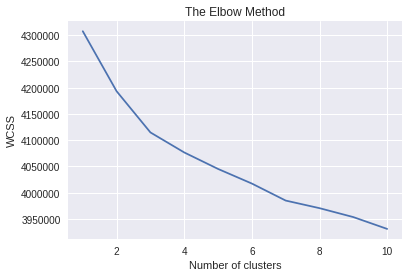

In [0]:
for i in range(1, 11):
    kmeans = KMeans(n_clusters = i, init ='k-means++', random_state = 0)
    kmeans.fit(X)
    wcss.append(kmeans.inertia_)
plt.plot(range(1, 11), wcss)
plt.title('The Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()

In [0]:
kmeans = KMeans(n_clusters = 7, init = 'k-means++', random_state = 0)
kmeans.fit(X)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=7, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=0, tol=0.0001, verbose=0)

In [0]:
len(kmeans.labels_)

75000

In [0]:
len(train_data)

75001

In [0]:
df=pd.DataFrame(train_data)

In [0]:
len(train_data)

75000

In [0]:
df['cluster']=kmeans.labels_

In [0]:
df['cluster'].value_counts()

1    58861
3     9837
0     2982
6     1953
4      954
2      406
5        7
Name: cluster, dtype: int64

In [0]:
!pip install wordcloud

Word cloud for cluster 0


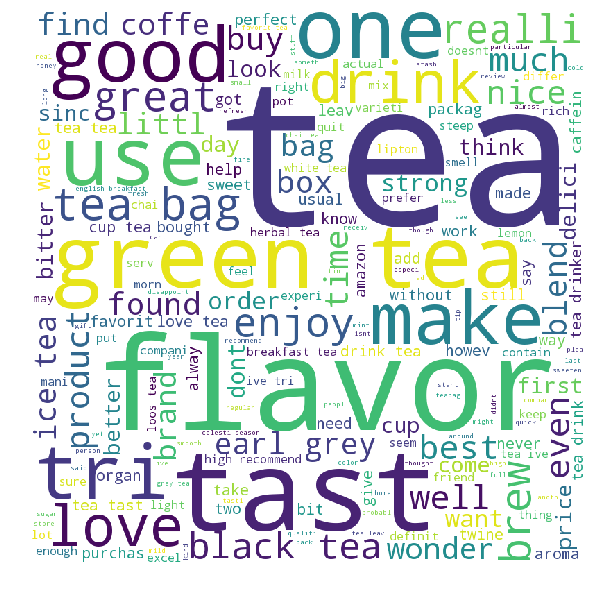

Word cloud for cluster 1


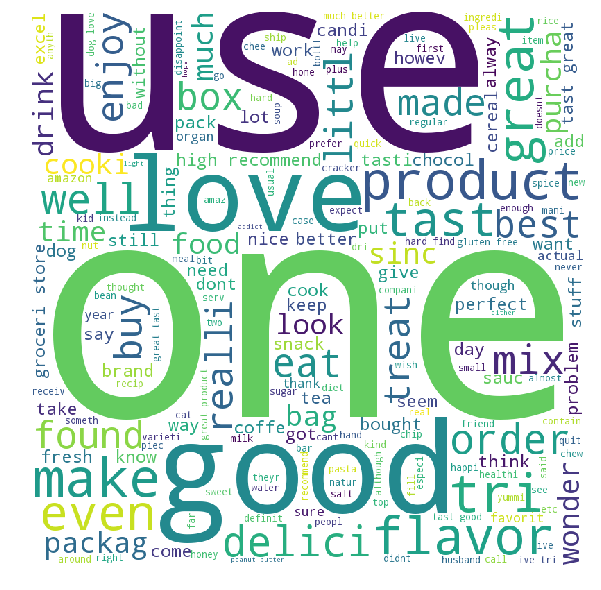

Word cloud for cluster 2


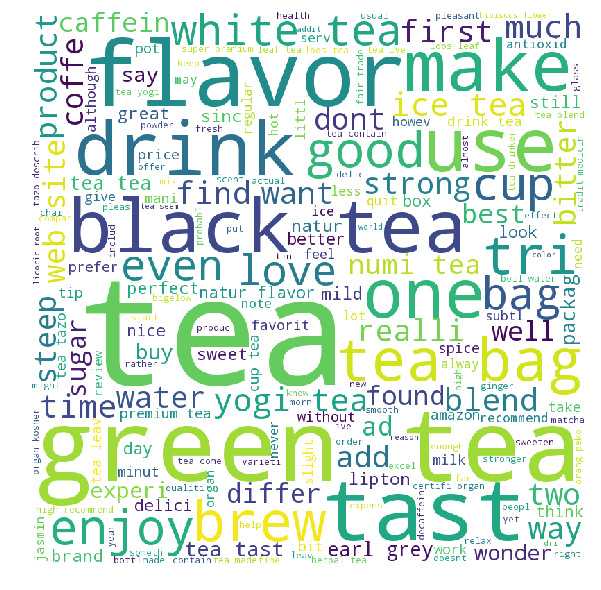

Word cloud for cluster 3


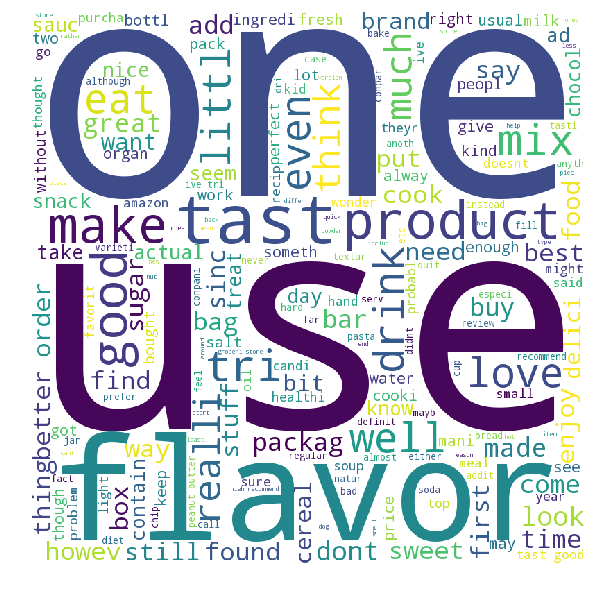

Word cloud for cluster 4


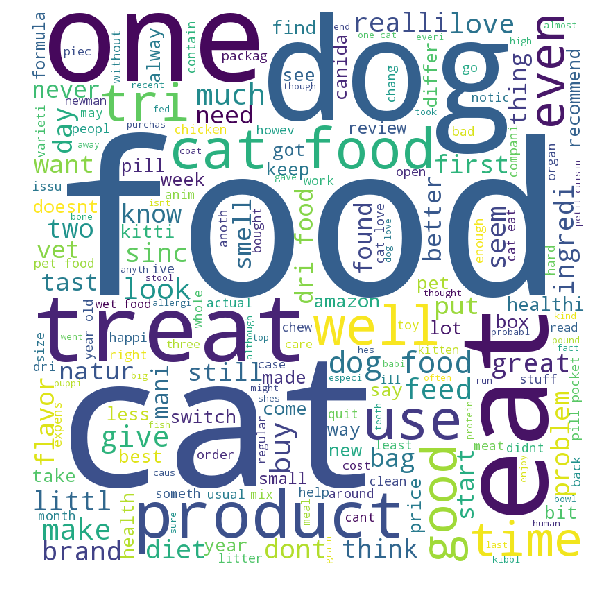

Word cloud for cluster 5


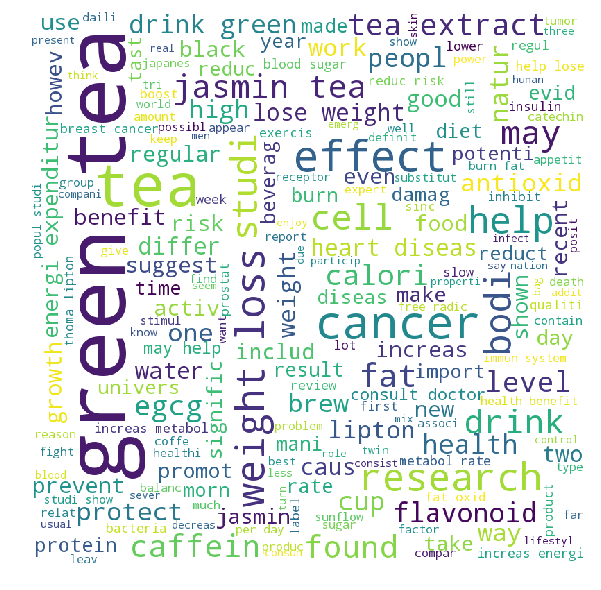

Word cloud for cluster 6


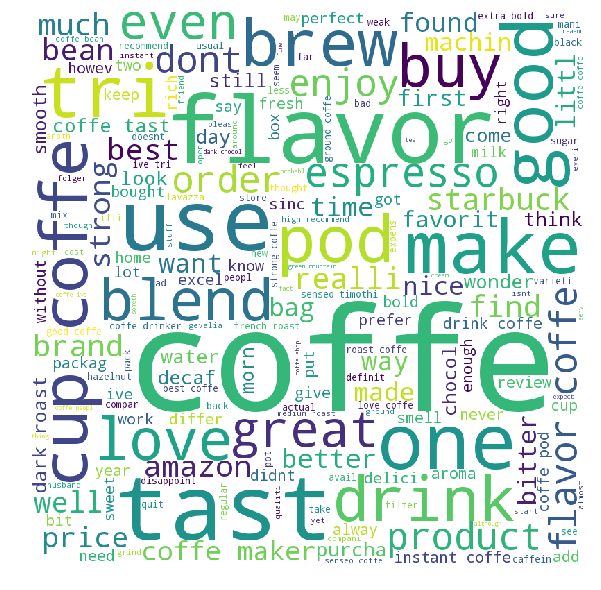

In [0]:

from wordcloud import WordCloud, STOPWORDS 
for j in  range(0,7):
 
  DF = df[df['cluster']==j]

  comment_words = ' '
  stopwords = set(STOPWORDS) 

  for val in DF.CleanedText:

	  val = str(val) 

	  tokens = val.split() 

	  for i in range(len(tokens)): 
		  tokens[i] = tokens[i].lower() 
		
	  for words in tokens: 
	    comment_words = comment_words + words + ' '

  print("Word cloud for cluster "+ str(j))
  wordcloud = WordCloud(width = 800, height = 800, background_color ='white', stopwords = stopwords, min_font_size =5,max_words =200).generate(comment_words)
	
  				 
  plt.figure(figsize = (8, 8), facecolor = None) 
  plt.imshow(wordcloud) 
  plt.axis("off") 
  plt.tight_layout(pad = 0) 

  plt.show() 


##Agglomirative Clustering

In [0]:
count_vect1 = CountVectorizer()
bag_of_words1 = count_vect.fit_transform(data.values)
print("the type of count vectorizer ",type(bag_of_words))
print("the shape of out text BOW vectorizer ",bag_of_words1.get_shape())
print("the number of unique words ", bag_of_words1.get_shape()[1])

the type of count vectorizer  <class 'scipy.sparse.csr.csr_matrix'>
the shape of out text BOW vectorizer  (5000, 11508)
the number of unique words  11508


In [0]:
from sklearn.cluster import AgglomerativeClustering

In [0]:
clf2=AgglomerativeClustering(n_clusters=2)
clf2.fit(bag_of_words1.toarray())

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='ward', memory=None, n_clusters=2,
            pooling_func=<function mean at 0x7fbb4be1d7b8>)

In [0]:
df_=pd.DataFrame(data,columns=['CleanedText'])
df_['clusters']=clf2.labels_
df_['clusters'].value_counts()


0    4878
1     122
Name: clusters, dtype: int64

Word cloud for cluster 0


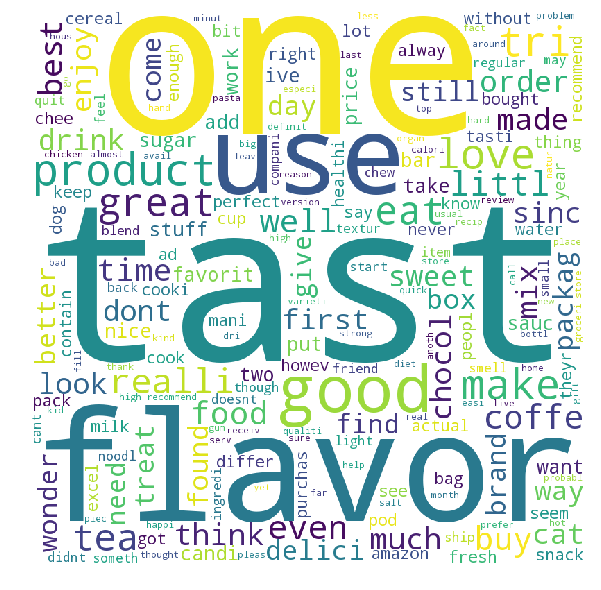

Word cloud for cluster 1


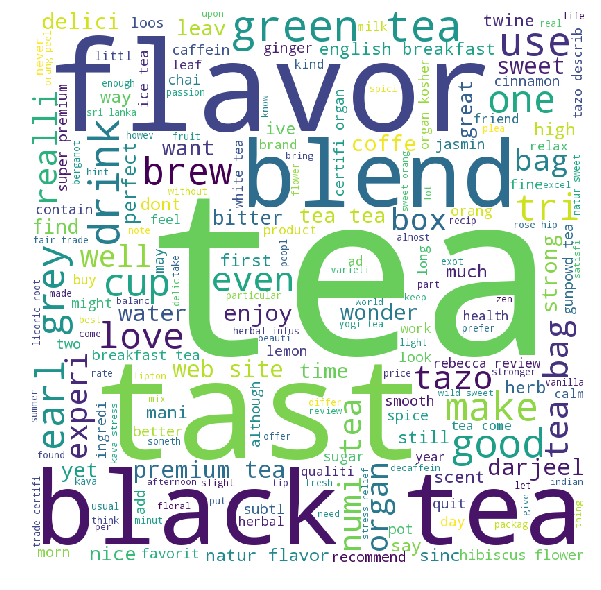

In [0]:

from wordcloud import WordCloud, STOPWORDS 
for j in  range(0,2):
 
  DF = df_[df_['clusters']==j]

  comment_words = ' '
  stopwords = set(STOPWORDS) 

  for val in DF.CleanedText:

	  val = str(val) 

	  tokens = val.split() 

	  for i in range(len(tokens)): 
		  tokens[i] = tokens[i].lower() 
		
	  for words in tokens: 
	    comment_words = comment_words + words + ' '

  print("Word cloud for cluster "+ str(j))
  wordcloud = WordCloud(width = 800, height = 800, background_color ='white', stopwords = stopwords, min_font_size =5,max_words =200).generate(comment_words)
	
  				 
  plt.figure(figsize = (8, 8), facecolor = None) 
  plt.imshow(wordcloud) 
  plt.axis("off") 
  plt.tight_layout(pad = 0) 

  plt.show() 


In [0]:
clf=AgglomerativeClustering(n_clusters=4)
clf.fit(bag_of_words1.toarray())

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='ward', memory=None, n_clusters=4,
            pooling_func=<function mean at 0x7fbb4be1d7b8>)

In [0]:
df_=pd.DataFrame(data,columns=['CleanedText'])

In [0]:
df_['clusters']=clf.labels_

Word cloud for cluster 0


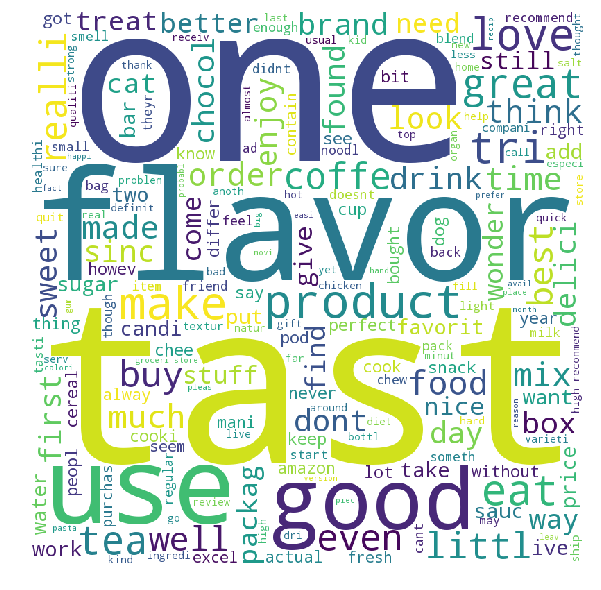

Word cloud for cluster 1


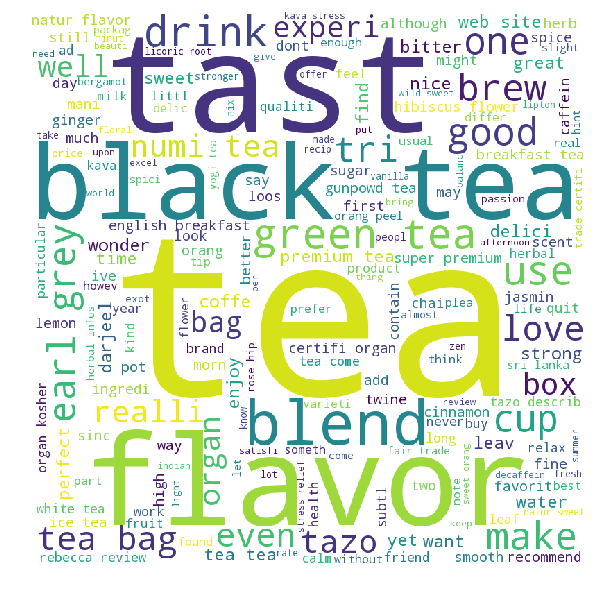

Word cloud for cluster 2


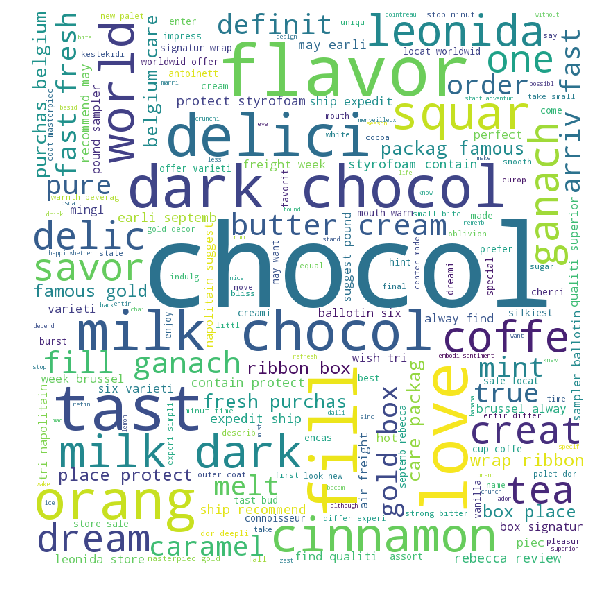

Word cloud for cluster 3


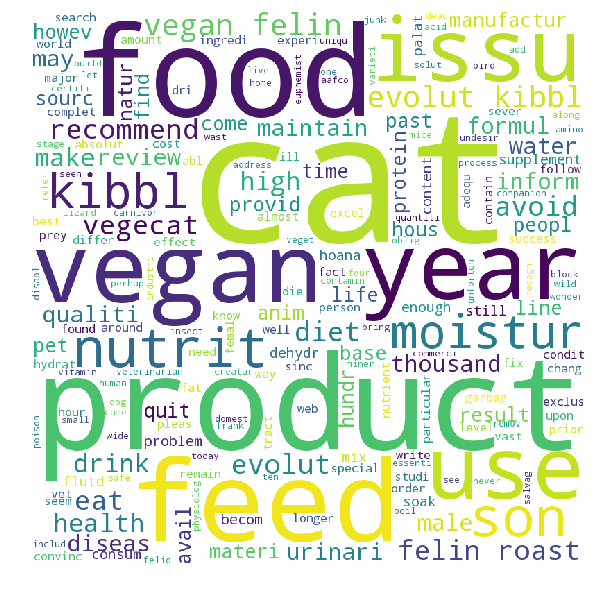

In [0]:

from wordcloud import WordCloud, STOPWORDS 
for j in  range(0,4):
 
  DF = df_[df_['clusters']==j]

  comment_words = ' '
  stopwords = set(STOPWORDS) 

  for val in DF.CleanedText:

	  val = str(val) 

	  tokens = val.split() 

	  for i in range(len(tokens)): 
		  tokens[i] = tokens[i].lower() 
		
	  for words in tokens: 
	    comment_words = comment_words + words + ' '

  print("Word cloud for cluster "+ str(j))
  wordcloud = WordCloud(width = 800, height = 800, background_color ='white', stopwords = stopwords, min_font_size =5,max_words =200).generate(comment_words)
	
  				 
  plt.figure(figsize = (8, 8), facecolor = None) 
  plt.imshow(wordcloud) 
  plt.axis("off") 
  plt.tight_layout(pad = 0) 

  plt.show() 


In [0]:
clf8=AgglomerativeClustering(n_clusters=8)
clf8.fit(bag_of_words1.toarray())

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='ward', memory=None, n_clusters=8,
            pooling_func=<function mean at 0x7fbb4be1d7b8>)

In [0]:

df_=pd.DataFrame(data,columns=['CleanedText'])
df_['clusters']=clf8.labels_
df_['clusters'].value_counts()

0    4178
1     357
2     324
4     122
3       7
6       6
5       5
7       1
Name: clusters, dtype: int64

Word cloud for cluster 0


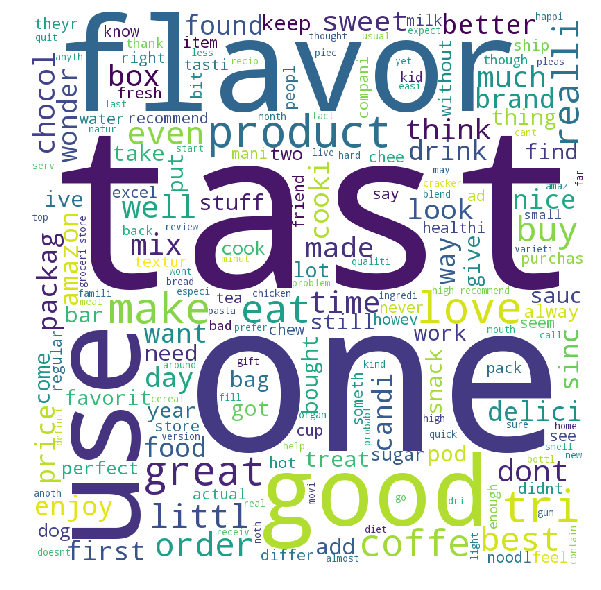

Word cloud for cluster 1


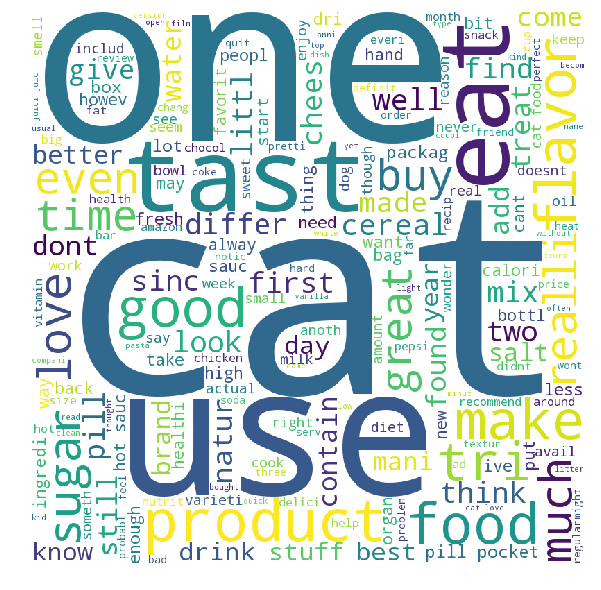

Word cloud for cluster 2


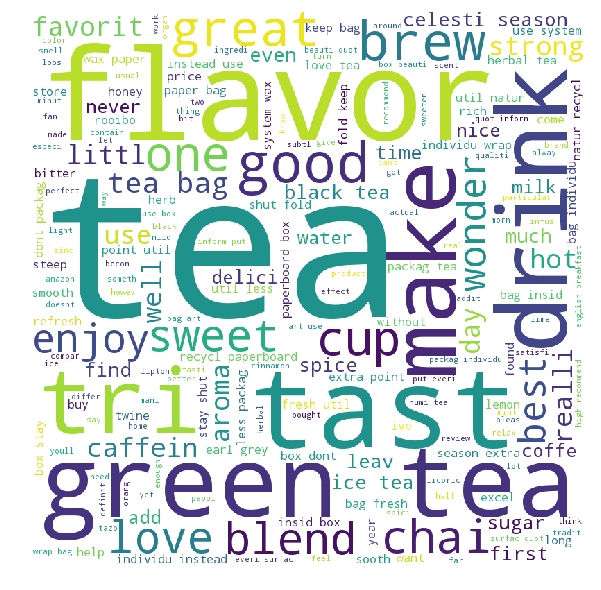

Word cloud for cluster 3


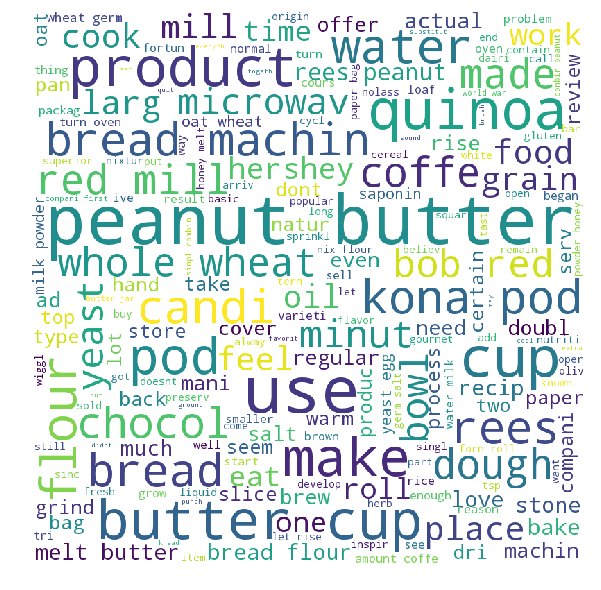

Word cloud for cluster 4


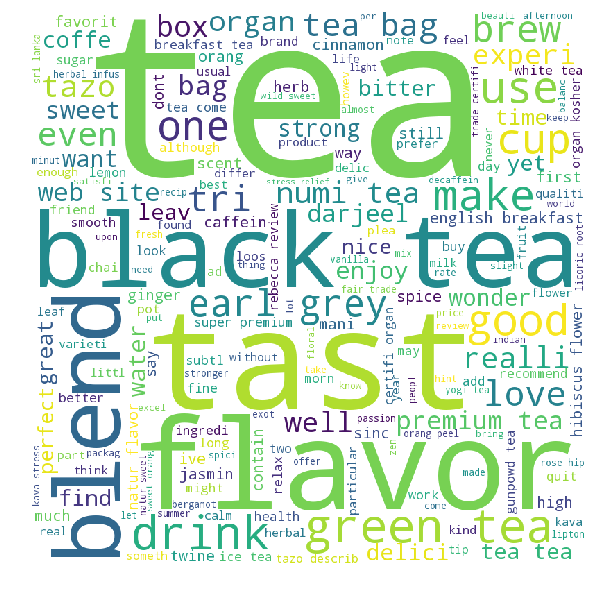

Word cloud for cluster 5


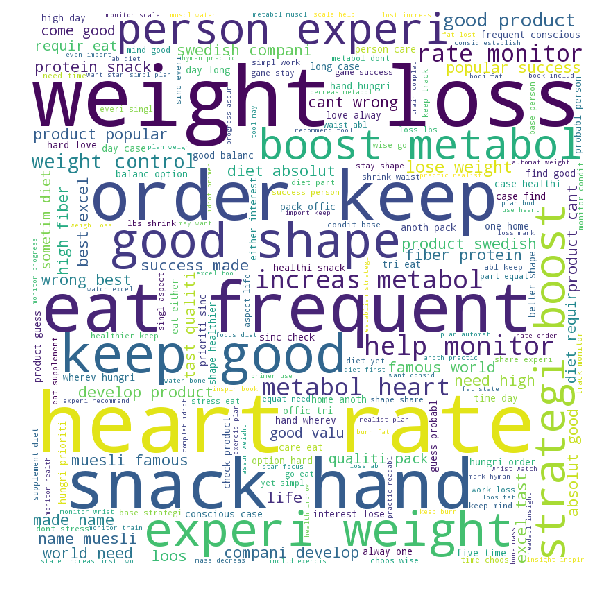

Word cloud for cluster 6


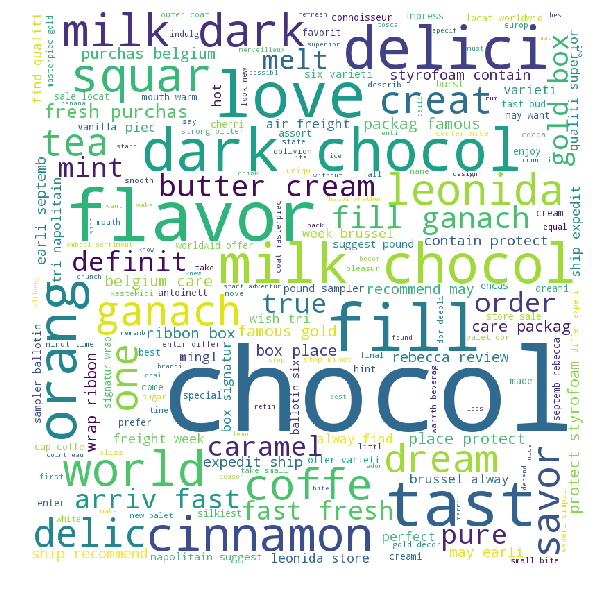

Word cloud for cluster 7


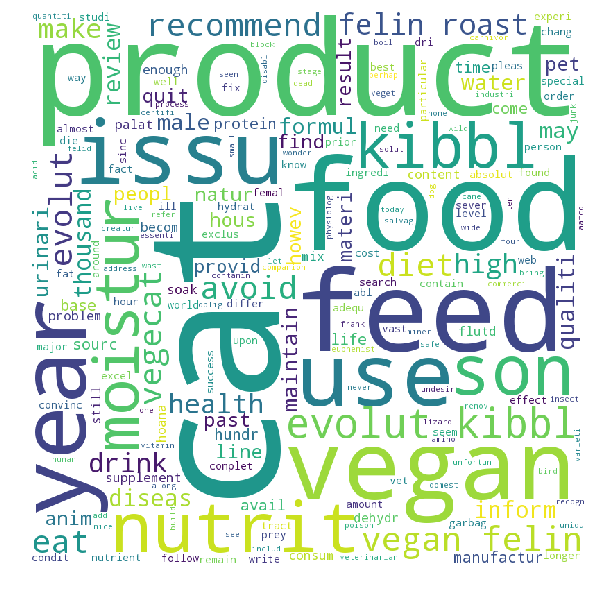

In [0]:


from wordcloud import WordCloud, STOPWORDS 
for j in  range(0,8):
 
  DF = df_[df_['clusters']==j]

  comment_words = ' '
  stopwords = set(STOPWORDS) 

  for val in DF.CleanedText:

	  val = str(val) 

	  tokens = val.split() 

	  for i in range(len(tokens)): 
		  tokens[i] = tokens[i].lower() 
		
	  for words in tokens: 
	    comment_words = comment_words + words + ' '

  print("Word cloud for cluster "+ str(j))
  wordcloud = WordCloud(width = 800, height = 800, background_color ='white', stopwords = stopwords, min_font_size =5,max_words =200).generate(comment_words)
	
  				 
  plt.figure(figsize = (8, 8), facecolor = None) 
  plt.imshow(wordcloud) 
  plt.axis("off") 
  plt.tight_layout(pad = 0) 

  plt.show() 


#TF-IDF

In [0]:
tf_idf_vect = TfidfVectorizer(ngram_range=(1,2))
final_tf_idf = tf_idf_vect.fit_transform(train_data)
print("the type of count vectorizer ",type(final_tf_idf))
print("the shape of out text TFIDF vectorizer ",final_tf_idf.get_shape())
print("the number of unique words including both unigrams and bigrams ", final_tf_idf.get_shape()[1])

the type of count vectorizer  <class 'scipy.sparse.csr.csr_matrix'>
the shape of out text TFIDF vectorizer  (75000, 965409)
the number of unique words including both unigrams and bigrams  965409


##K MEANS

1
2
3
4
5
6
7
8
9
10


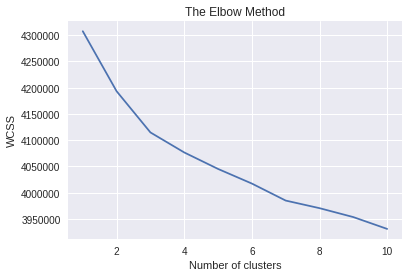

In [0]:
wcss=[]
for i in range(1, 11):
    kmeans = KMeans(n_clusters = i, init ='k-means++', random_state = 0)
    kmeans.fit(final_tf_idf)
    wcss.append(kmeans.inertia_)
    print(i)
plt.plot(range(1, 11), wcss)
plt.title('The Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()

In [0]:
kmeans = KMeans(n_clusters = 6, init = 'k-means++', random_state = 0)
kmeans.fit(final_tf_idf)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=6, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=0, tol=0.0001, verbose=0)

In [0]:
kmeans.labels_

In [0]:
df=pd.DataFrame(train_data)

In [0]:
df['cluster']=kmeans.labels_

In [0]:
df.head()

,CleanedText,cluster
138706,witti littl book make son laugh loud recit car...,4
138683,rememb see show air televis year ago child sis...,4
417839,beetlejuic well written movi everyth excel act...,4
346055,twist rumplestiskin captur film star michael k...,4
417838,beetlejuic excel funni movi keaton hilari wack...,4


In [0]:
df['cluster'].value_counts()

5    42687
0    13585
4     5477
2     4779
1     4435
3     4037
Name: cluster, dtype: int64

In [0]:
!pip install wordcloud

Word cloud for cluster 0


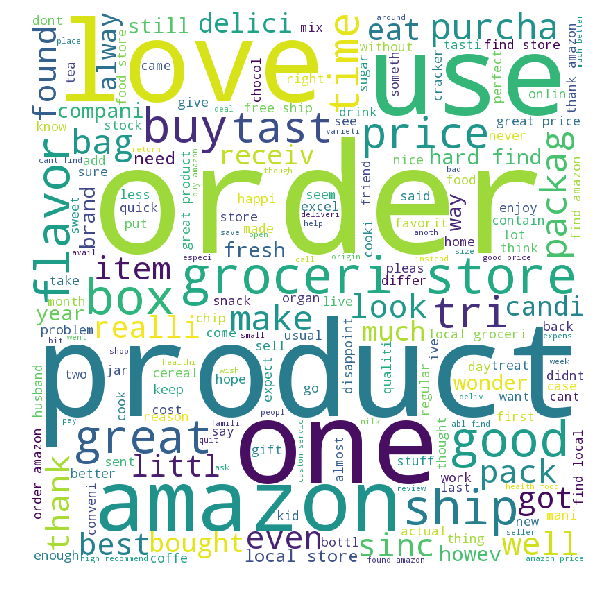

Word cloud for cluster 1


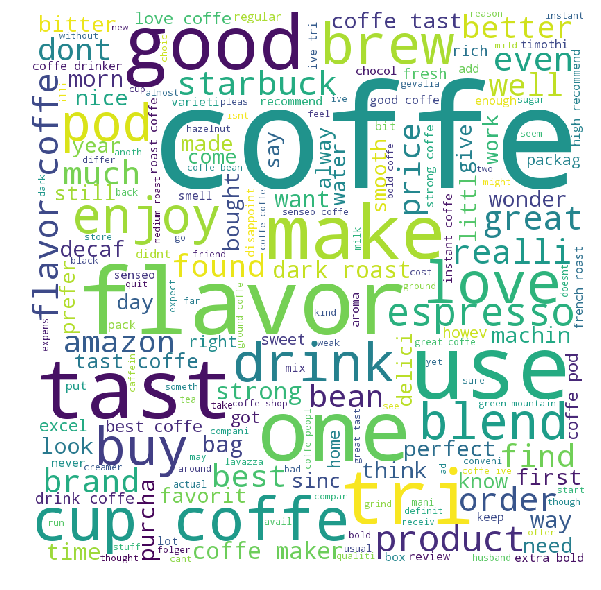

Word cloud for cluster 2


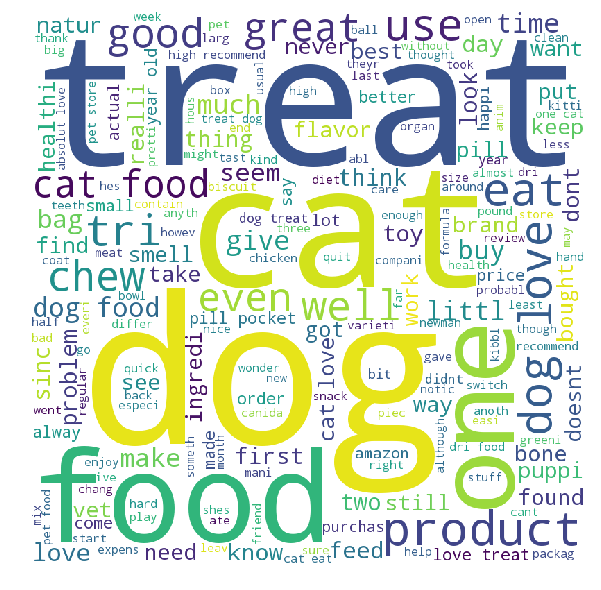

Word cloud for cluster 3


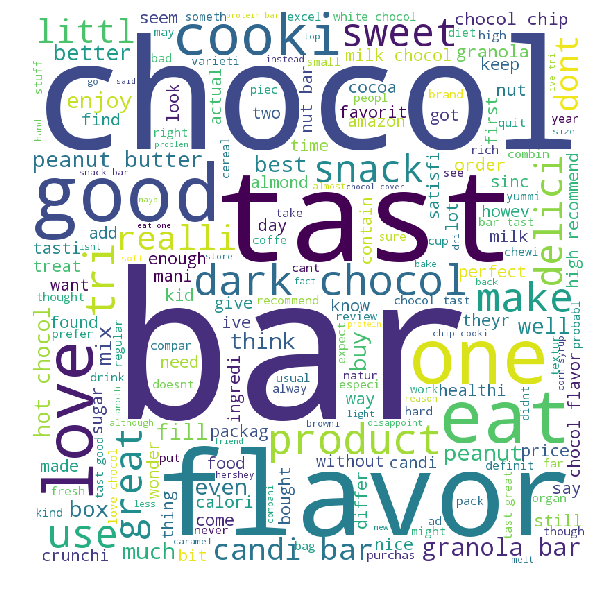

Word cloud for cluster 4


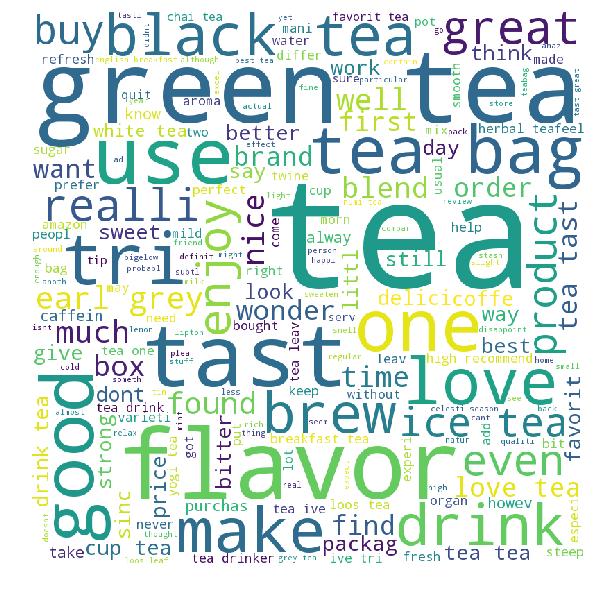

Word cloud for cluster 5


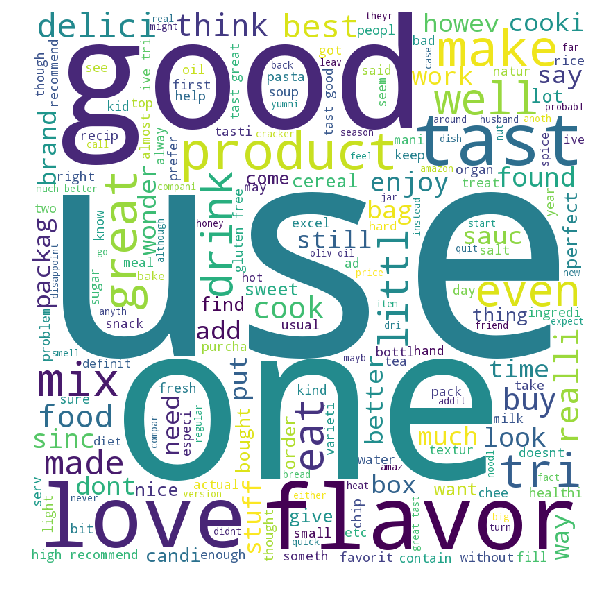

In [0]:

from wordcloud import WordCloud, STOPWORDS 
for j in  range(0,6):
 
  DF = df[df['cluster']==j]

  comment_words = ' '
  stopwords = set(STOPWORDS) 

  for val in DF.CleanedText:

	  val = str(val) 

	  tokens = val.split() 

	  for i in range(len(tokens)): 
		  tokens[i] = tokens[i].lower() 
		
	  for words in tokens: 
	    comment_words = comment_words + words + ' '

  print("Word cloud for cluster "+ str(j))
  wordcloud = WordCloud(width = 800, height = 800, background_color ='white', stopwords = stopwords, min_font_size =5,max_words =200).generate(comment_words)
	
  				 
  plt.figure(figsize = (8, 8), facecolor = None) 
  plt.imshow(wordcloud) 
  plt.axis("off") 
  plt.tight_layout(pad = 0) 

  plt.show() 


##AgglomerativeClustering

In [0]:
tf_idf_vect = TfidfVectorizer()
final_tf_idf1 = tf_idf_vect.fit_transform(data)
print("the type of count vectorizer ",type(final_tf_idf1))
print("the shape of out text TFIDF vectorizer ",final_tf_idf1.get_shape())
print("the number of unique words including both unigrams and bigrams ", final_tf_idf1.get_shape()[1])

the type of count vectorizer  <class 'scipy.sparse.csr.csr_matrix'>
the shape of out text TFIDF vectorizer  (5000, 11508)
the number of unique words including both unigrams and bigrams  11508


In [0]:
clf2=AgglomerativeClustering(n_clusters=2)
clf2.fit(final_tf_idf1.toarray())

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='ward', memory=None, n_clusters=2,
            pooling_func=<function mean at 0x7fbb4be1d7b8>)

In [0]:

df_=pd.DataFrame(data,columns=['CleanedText'])
df_['clusters']=clf2.labels_
df_['clusters'].value_counts()

0    4512
1     488
Name: clusters, dtype: int64

Word cloud for cluster 0


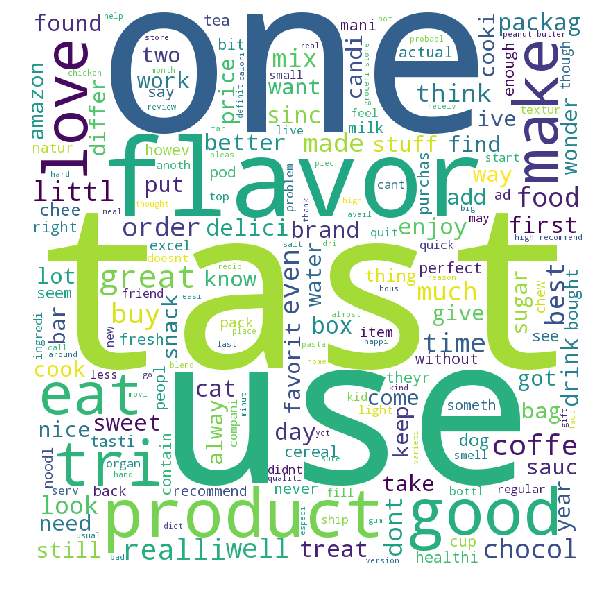

Word cloud for cluster 1


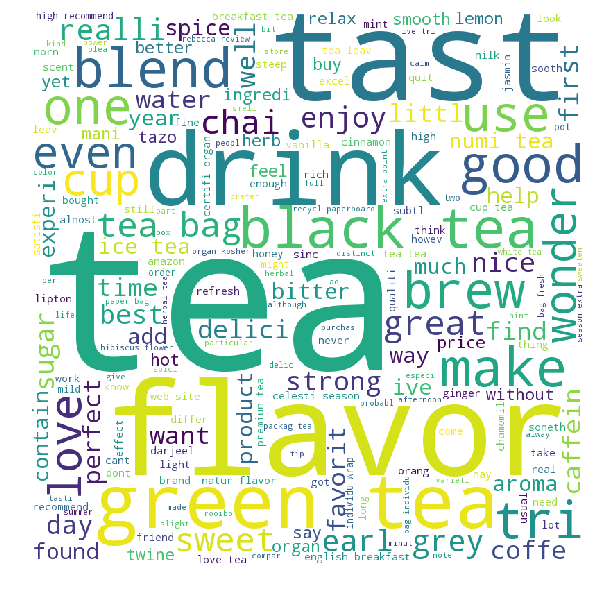

In [0]:

from wordcloud import WordCloud, STOPWORDS 
for j in  range(0,2):
 
  DF = df_[df_['clusters']==j]

  comment_words = ' '
  stopwords = set(STOPWORDS) 

  for val in DF.CleanedText:

	  val = str(val) 

	  tokens = val.split() 

	  for i in range(len(tokens)): 
		  tokens[i] = tokens[i].lower() 
		
	  for words in tokens: 
	    comment_words = comment_words + words + ' '

  print("Word cloud for cluster "+ str(j))
  wordcloud = WordCloud(width = 800, height = 800, background_color ='white', stopwords = stopwords, min_font_size =5,max_words =200).generate(comment_words)
	
  				 
  plt.figure(figsize = (8, 8), facecolor = None) 
  plt.imshow(wordcloud) 
  plt.axis("off") 
  plt.tight_layout(pad = 0) 

  plt.show() 


In [0]:
clf5=AgglomerativeClustering(n_clusters=5)
clf5.fit(final_tf_idf1.toarray())

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='ward', memory=None, n_clusters=5,
            pooling_func=<function mean at 0x7fbb4be1d7b8>)

In [0]:
df_=pd.DataFrame(data,columns=['CleanedText'])
df_['clusters']=clf5.labels_
df_['clusters'].value_counts()

0    3934
3     488
2     324
1     144
4     110
Name: clusters, dtype: int64

Word cloud for cluster 0


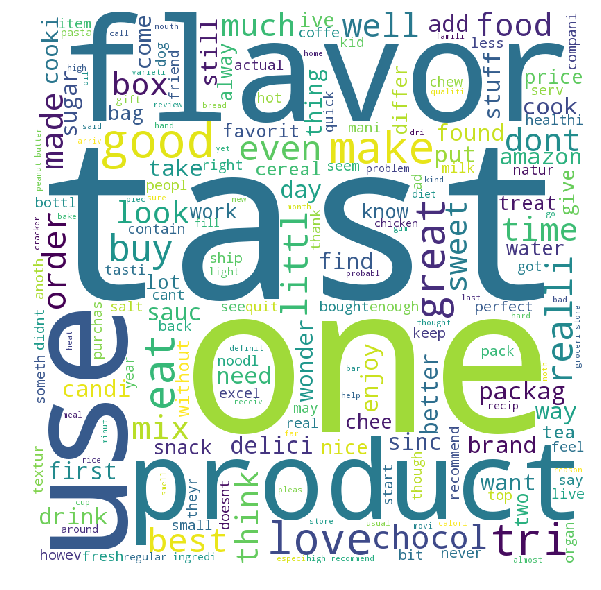

Word cloud for cluster 1


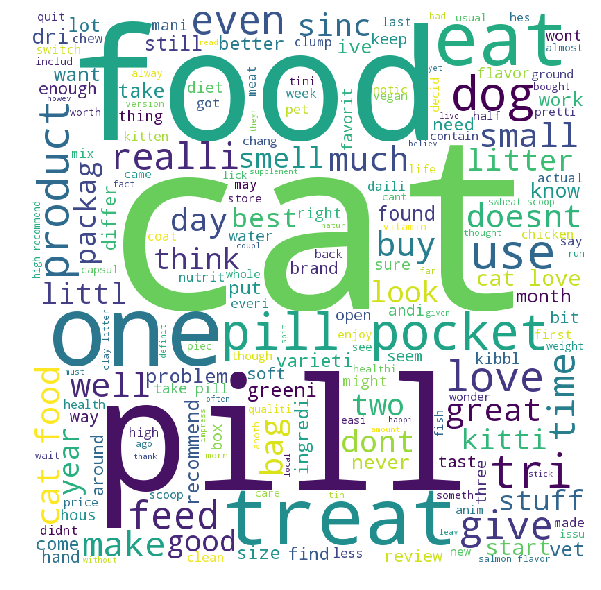

Word cloud for cluster 2


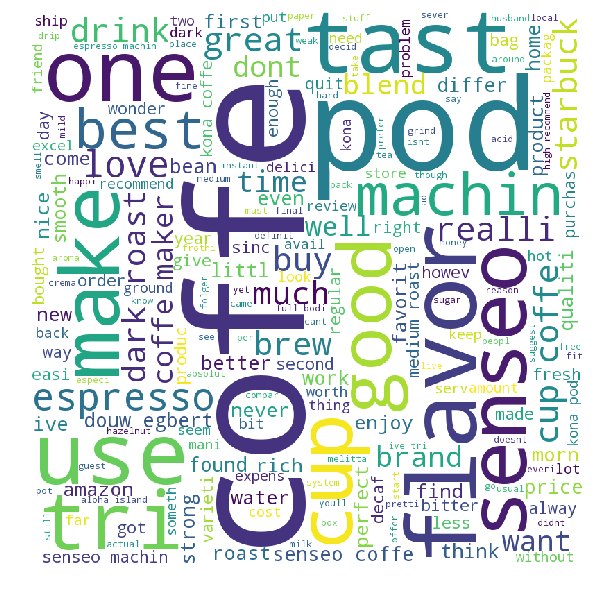

Word cloud for cluster 3


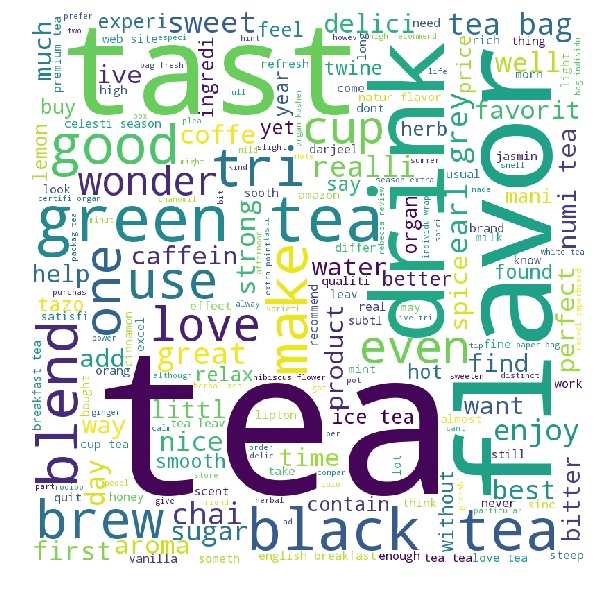

Word cloud for cluster 4


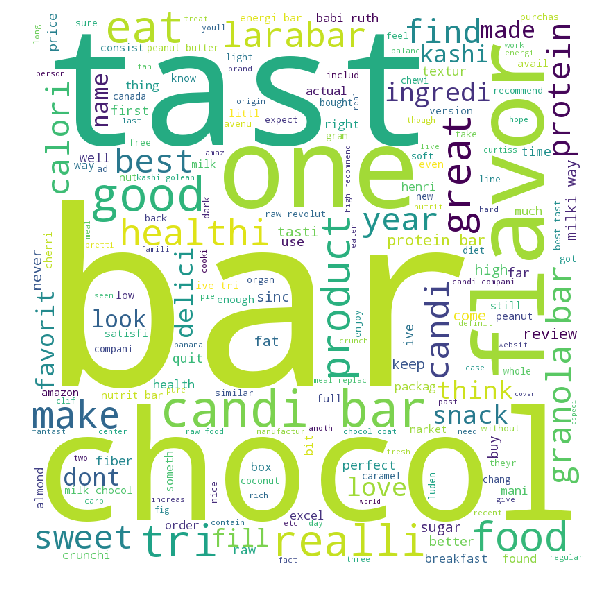

In [0]:
from wordcloud import WordCloud, STOPWORDS 
for j in  range(0,5):
 
  DF = df_[df_['clusters']==j]

  comment_words = ' '
  stopwords = set(STOPWORDS) 

  for val in DF.CleanedText:

	  val = str(val) 

	  tokens = val.split() 

	  for i in range(len(tokens)): 
		  tokens[i] = tokens[i].lower() 
		
	  for words in tokens: 
	    comment_words = comment_words + words + ' '

  print("Word cloud for cluster "+ str(j))
  wordcloud = WordCloud(width = 800, height = 800, background_color ='white', stopwords = stopwords, min_font_size =5,max_words =200).generate(comment_words)
	
  				 
  plt.figure(figsize = (8, 8), facecolor = None) 
  plt.imshow(wordcloud) 
  plt.axis("off") 
  plt.tight_layout(pad = 0) 

  plt.show() 

In [0]:
clf8=AgglomerativeClustering(n_clusters=8)
clf8.fit(final_tf_idf1.toarray())

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='ward', memory=None, n_clusters=8,
            pooling_func=<function mean at 0x7fbb4be1d7b8>)

In [0]:

df_=pd.DataFrame(data,columns=['CleanedText'])
df_['clusters']=clf8.labels_
df_['clusters'].value_counts()

1    3711
3     488
2     324
0     144
4     110
6     104
5      68
7      51
Name: clusters, dtype: int64

Word cloud for cluster 0


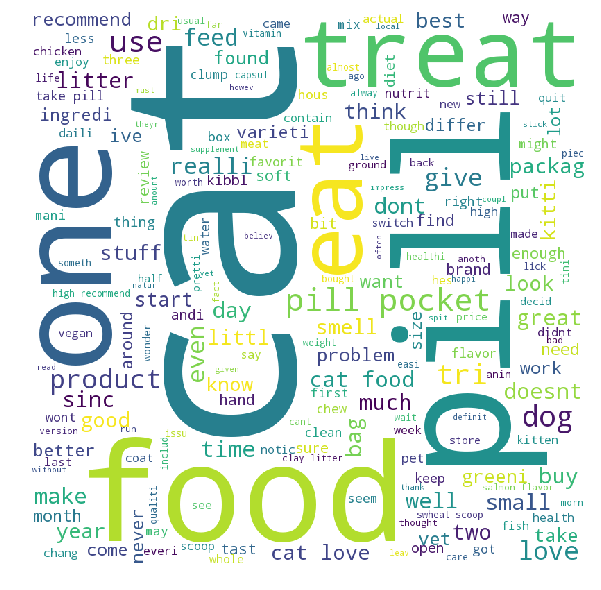

Word cloud for cluster 1


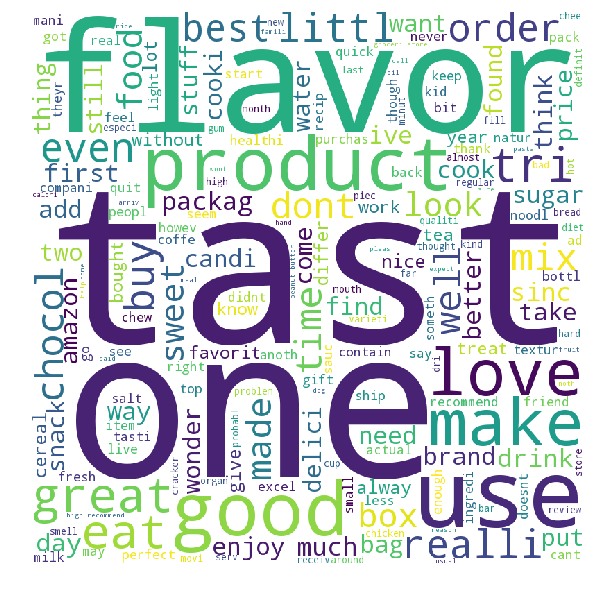

Word cloud for cluster 2


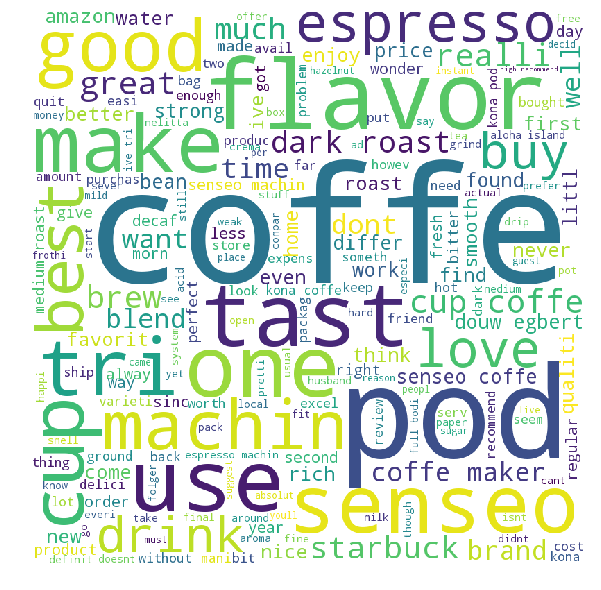

Word cloud for cluster 3


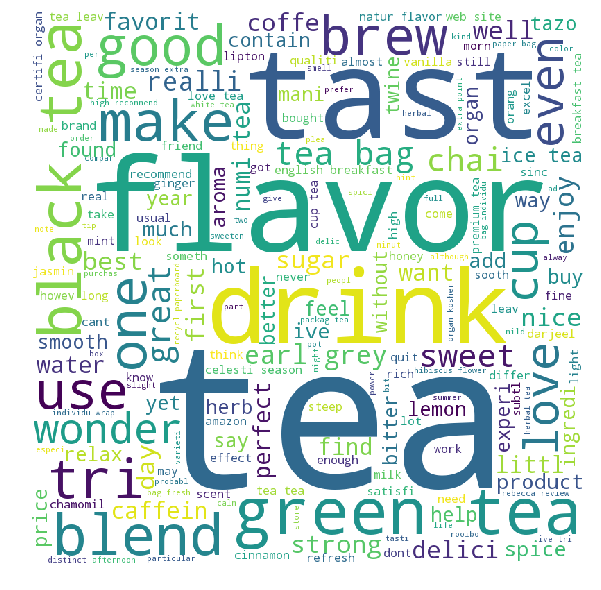

Word cloud for cluster 4


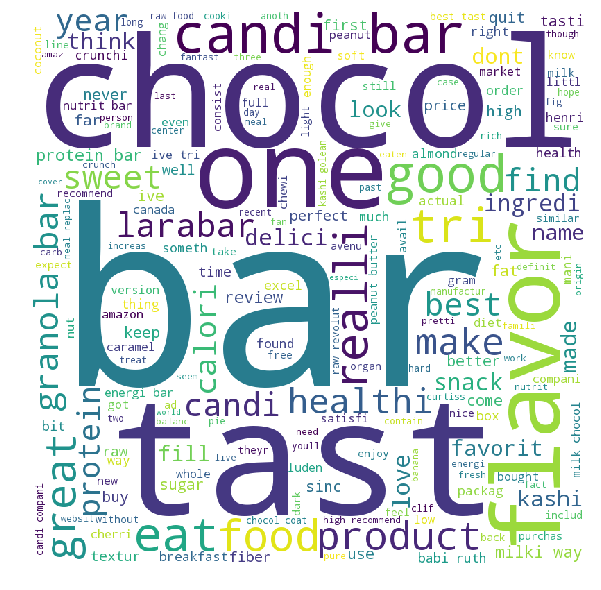

Word cloud for cluster 5


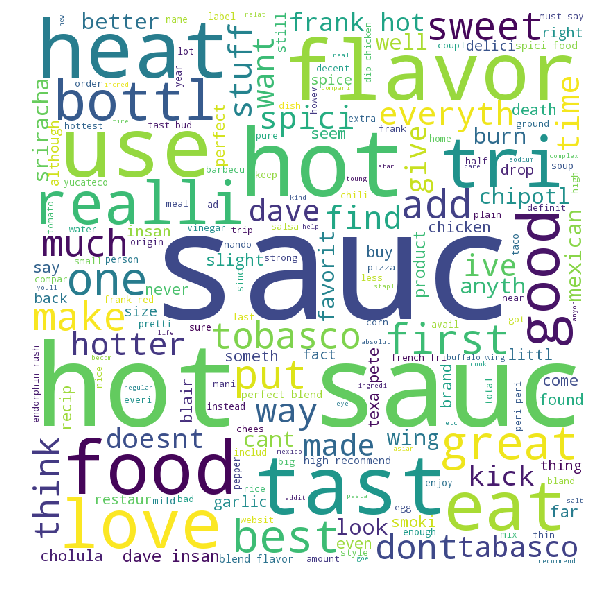

Word cloud for cluster 6


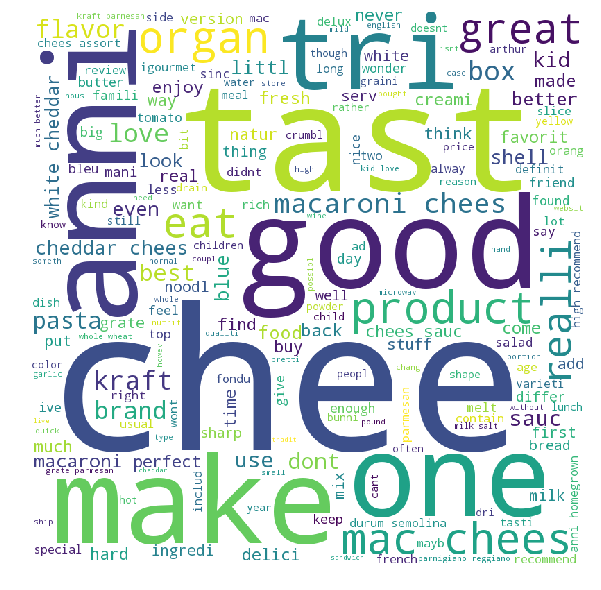

Word cloud for cluster 7


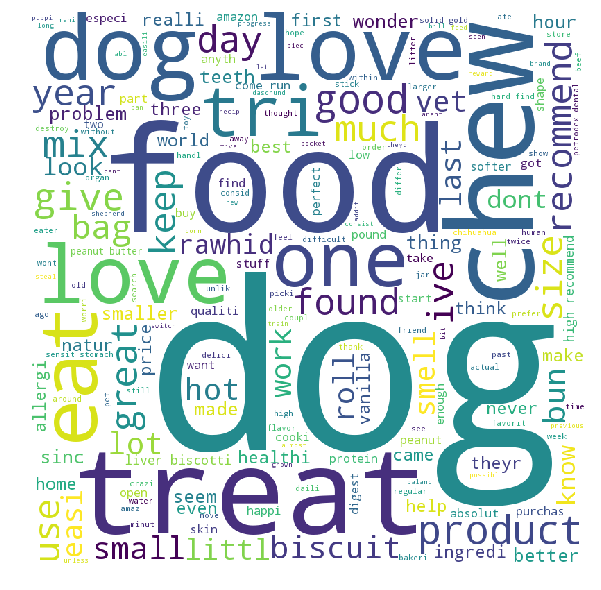

In [0]:
from wordcloud import WordCloud, STOPWORDS 
for j in  range(0,8):
 
  DF = df_[df_['clusters']==j]

  comment_words = ' '
  stopwords = set(STOPWORDS) 

  for val in DF.CleanedText:

	  val = str(val) 

	  tokens = val.split() 

	  for i in range(len(tokens)): 
		  tokens[i] = tokens[i].lower() 
		
	  for words in tokens: 
	    comment_words = comment_words + words + ' '

  print("Word cloud for cluster "+ str(j))
  wordcloud = WordCloud(width = 800, height = 800, background_color ='white', stopwords = stopwords, min_font_size =5,max_words =200).generate(comment_words)
	
  				 
  plt.figure(figsize = (8, 8), facecolor = None) 
  plt.imshow(wordcloud) 
  plt.axis("off") 
  plt.tight_layout(pad = 0) 

  plt.show() 

# Word to Vec

In [0]:
data=pd.read_pickle('CleanedText')

In [0]:
train_data=data.head(60000)

In [0]:
i=0
list_of_sent=[]
for sent in train_data:
    list_of_sent.append(sent.split())

In [0]:
len(list_of_sent)

60000

In [0]:
w2v_model=Word2Vec(list_of_sent,min_count=5,size=50, workers=4)

In [0]:
w2v_words = list(w2v_model.wv.vocab)
print("number of words that occured minimum 5 times ",len(w2v_words))
print("sample words ", w2v_words[0:50])

number of words that occured minimum 5 times  9957
sample words  ['witti', 'littl', 'book', 'make', 'son', 'laugh', 'loud', 'car', 'drive', 'along', 'alway', 'sing', 'refrain', 'hes', 'learn', 'whale', 'india', 'droop', 'love', 'new', 'word', 'introduc', 'silli', 'classic', 'will', 'bet', 'still', 'abl', 'memori', 'colleg', 'rememb', 'see', 'show', 'air', 'televis', 'year', 'ago', 'child', 'sister', 'later', 'bought', 'day', 'thirti', 'someth', 'use', 'seri', 'song', 'student', 'teach', 'preschool']


# AVG WORD2VEC

In [0]:
sent_vectors = []
for sent in list_of_sent:
    sent_vec = np.zeros(50) 
    cnt_words =0; 
    for word in sent: 
        if word in w2v_words:
            vec = w2v_model.wv[word]
            sent_vec += vec
            cnt_words += 1
    if cnt_words != 0:
        sent_vec /= cnt_words
    sent_vectors.append(sent_vec)


##K MEANS

1
2
3
4
5
6
7
8
9
10


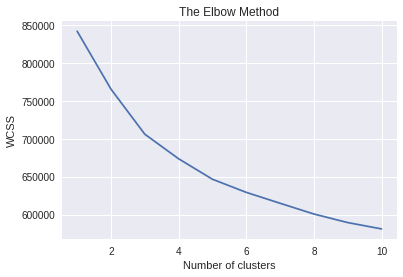

In [0]:
wcss=[]
for i in range(1, 11):
    kmeans = KMeans(n_clusters = i, init ='k-means++', random_state = 0)
    kmeans.fit(sent_vectors)
    wcss.append(kmeans.inertia_)
    print(i)
plt.plot(range(1, 11), wcss)
plt.title('The Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()

In [0]:
kmeans = KMeans(n_clusters = 8, init ='k-means++', random_state = 0)
kmeans.fit(sent_vectors)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=8, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=0, tol=0.0001, verbose=0)

In [0]:
df=pd.DataFrame(train_data)

In [0]:
df.columns

Index(['CleanedText'], dtype='object')

In [0]:

df['clusters']=kmeans.labels_

In [0]:
df['clusters'].value_counts()

5    16622
7    12320
6    11164
2     9730
1     9015
4     5843
3     5665
0     4641
Name: clusters, dtype: int64

Word cloud for cluster 0


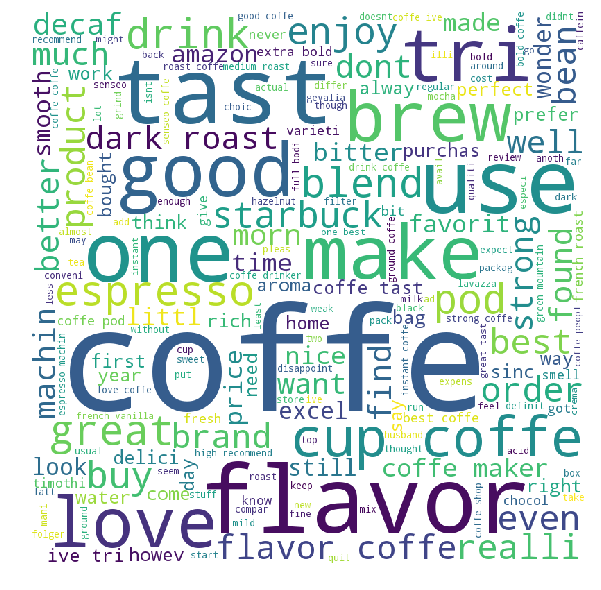

Word cloud for cluster 1


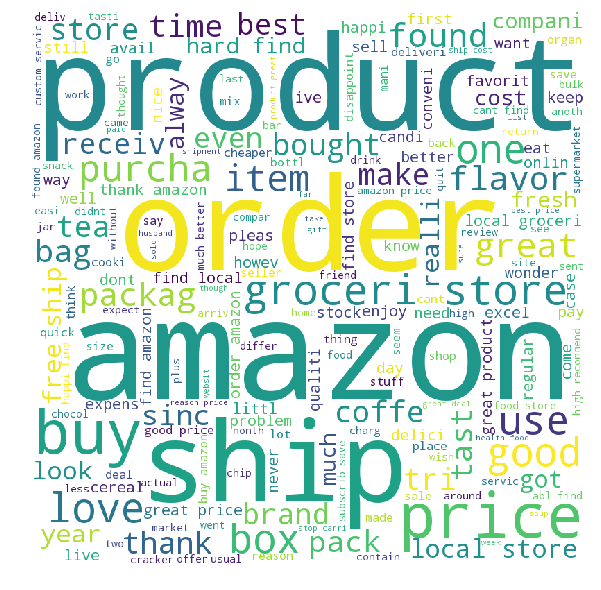

Word cloud for cluster 2


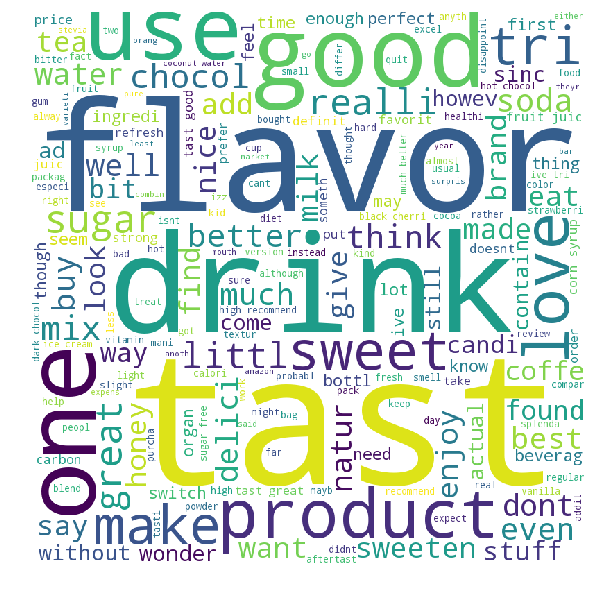

Word cloud for cluster 3


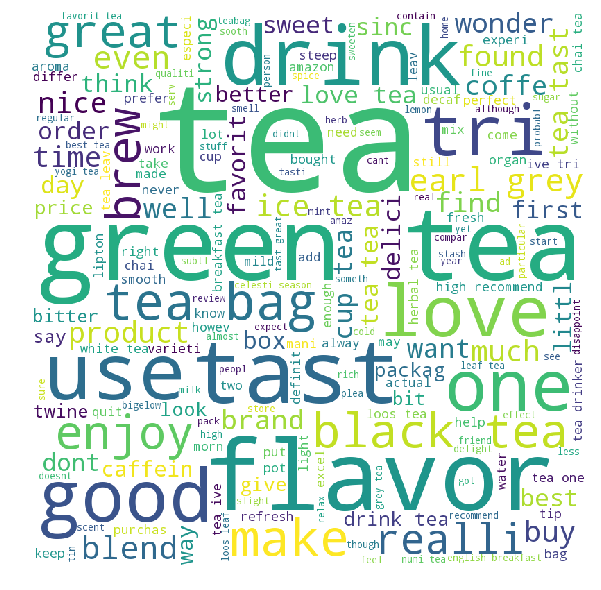

Word cloud for cluster 4


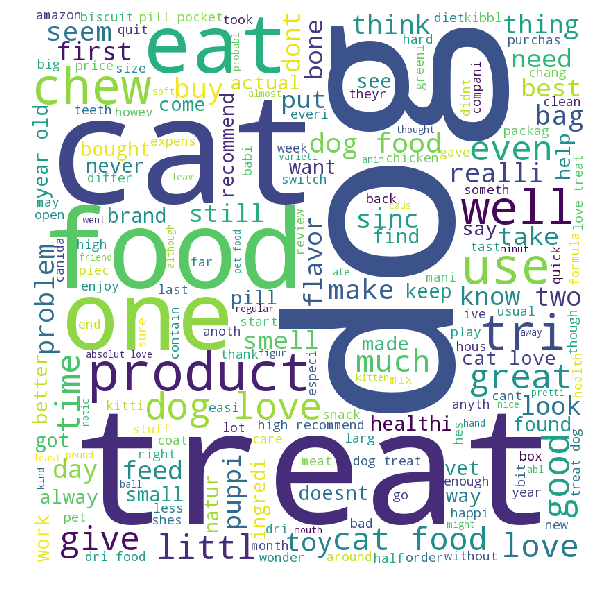

Word cloud for cluster 5


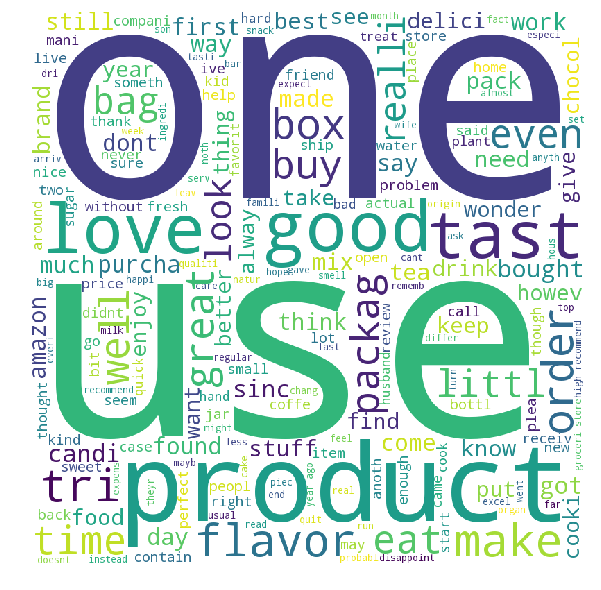

Word cloud for cluster 6


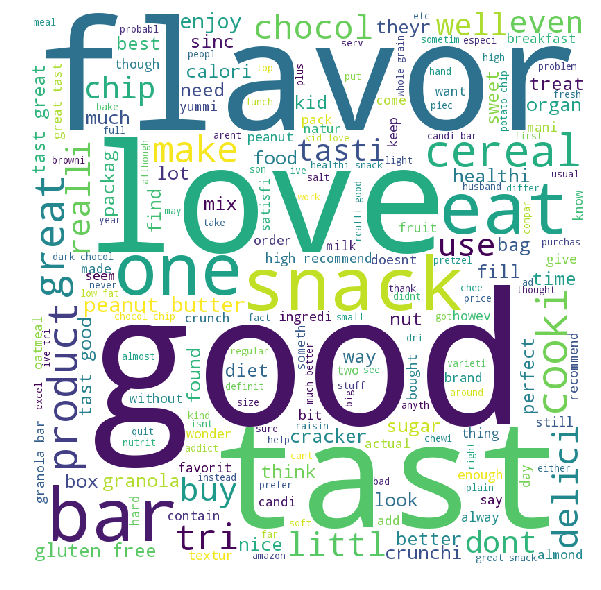

Word cloud for cluster 7


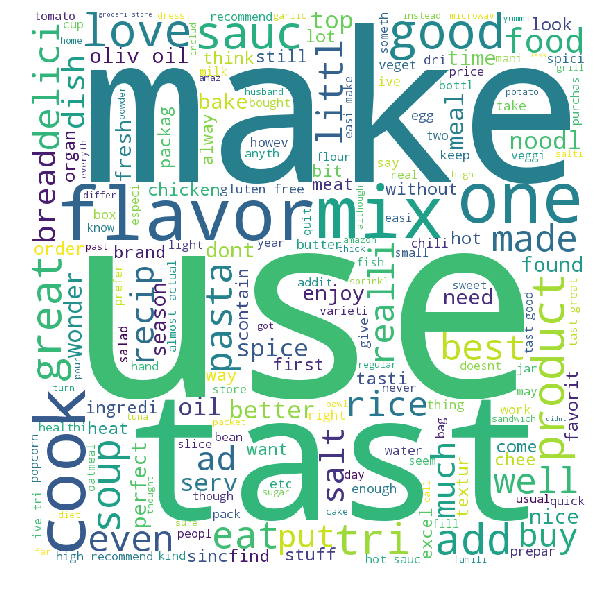

Word cloud for cluster 8


ValueError: ignored

In [0]:

from wordcloud import WordCloud, STOPWORDS 
for j in  range(0,9):
 
  DF = df[df['clusters']==j]

  comment_words = ' '
  stopwords = set(STOPWORDS) 

  for val in DF.CleanedText:

	  val = str(val) 

	  tokens = val.split() 

	  for i in range(len(tokens)): 
		  tokens[i] = tokens[i].lower() 
		
	  for words in tokens: 
	    comment_words = comment_words + words + ' '

  print("Word cloud for cluster "+ str(j))
  wordcloud = WordCloud(width = 800, height = 800, background_color ='white', stopwords = stopwords, min_font_size =5,max_words =200).generate(comment_words)
	
  				 
  plt.figure(figsize = (8, 8), facecolor = None) 
  plt.imshow(wordcloud) 
  plt.axis("off") 
  plt.tight_layout(pad = 0) 

  plt.show() 


##Agglomerative

In [0]:
new_sent_vectors=sent_vectors[0:5000]

In [0]:
X_=np.array(new_sent_vectors)

In [0]:
clf2=AgglomerativeClustering(n_clusters=2)
clf2.fit(X_)



AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='ward', memory=None, n_clusters=2,
            pooling_func=<function mean at 0x7fbb4be1d7b8>)

In [0]:
df_=pd.DataFrame(data,columns=['CleanedText'])
df_['clusters']=clf2.labels_
df_['clusters'].value_counts()

0    4129
1     871
Name: clusters, dtype: int64

Word cloud for cluster 0


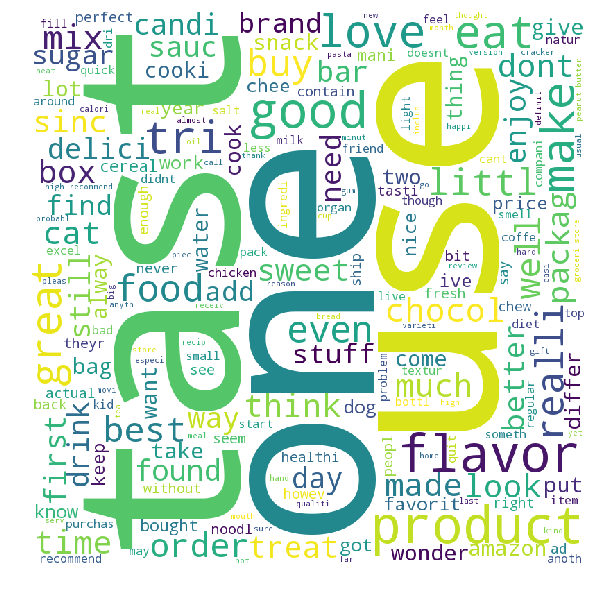

Word cloud for cluster 1


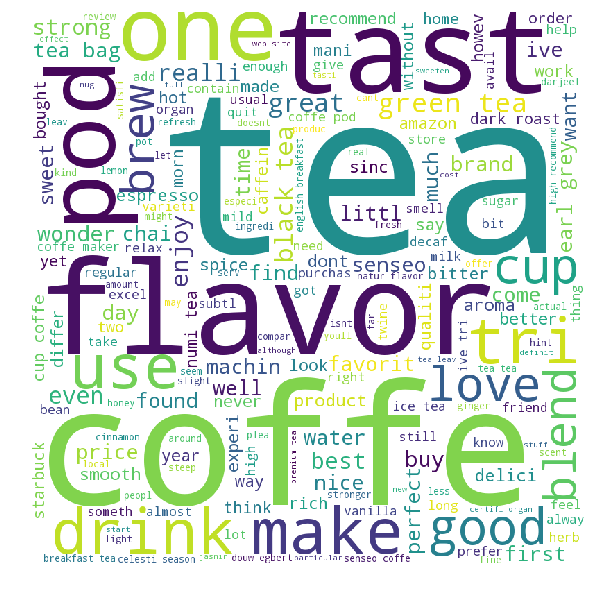

In [0]:

from wordcloud import WordCloud, STOPWORDS 
for j in  range(0,2):
 
  DF = df_[df_['clusters']==j]

  comment_words = ' '
  stopwords = set(STOPWORDS) 

  for val in DF.CleanedText:

	  val = str(val) 

	  tokens = val.split() 

	  for i in range(len(tokens)): 
		  tokens[i] = tokens[i].lower() 
		
	  for words in tokens: 
	    comment_words = comment_words + words + ' '

  print("Word cloud for cluster "+ str(j))
  wordcloud = WordCloud(width = 800, height = 800, background_color ='white', stopwords = stopwords, min_font_size =5,max_words =200).generate(comment_words)
	
  				 
  plt.figure(figsize = (8, 8), facecolor = None) 
  plt.imshow(wordcloud) 
  plt.axis("off") 
  plt.tight_layout(pad = 0) 

  plt.show() 

In [0]:
clf5=AgglomerativeClustering(n_clusters=5)
clf5.fit(X_)



AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='ward', memory=None, n_clusters=5,
            pooling_func=<function mean at 0x7fbb4be1d7b8>)

In [0]:
df_=pd.DataFrame(data,columns=['CleanedText'])
df_['clusters']=clf5.labels_
df_['clusters'].value_counts()

1    1524
2    1258
0     871
4     696
3     651
Name: clusters, dtype: int64

Word cloud for cluster 0


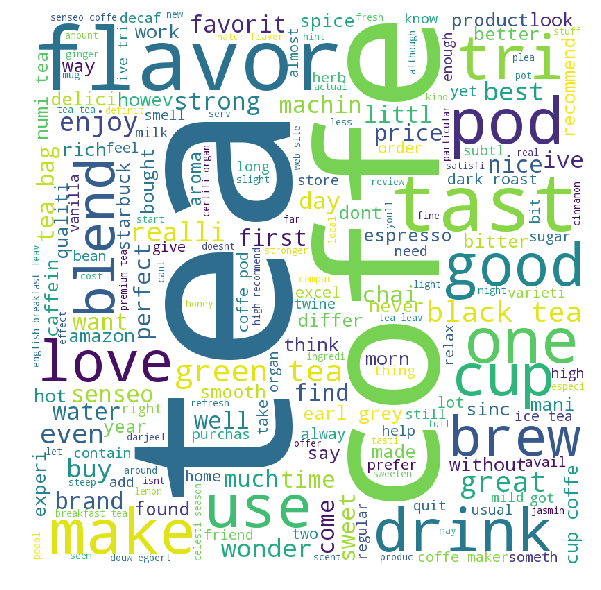

Word cloud for cluster 1


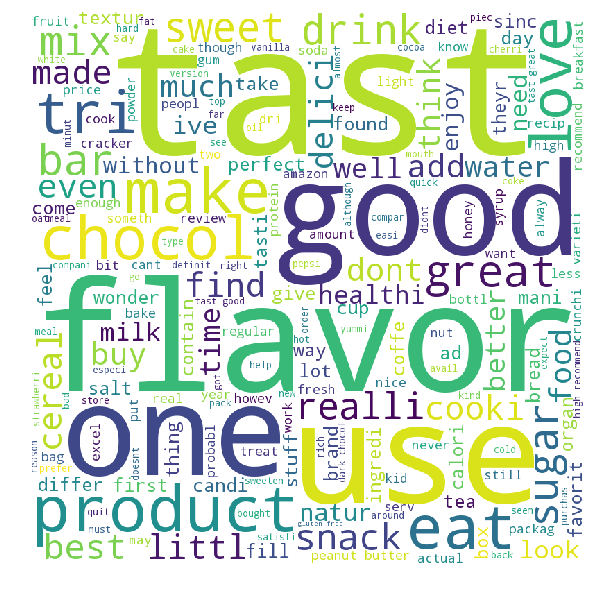

Word cloud for cluster 2


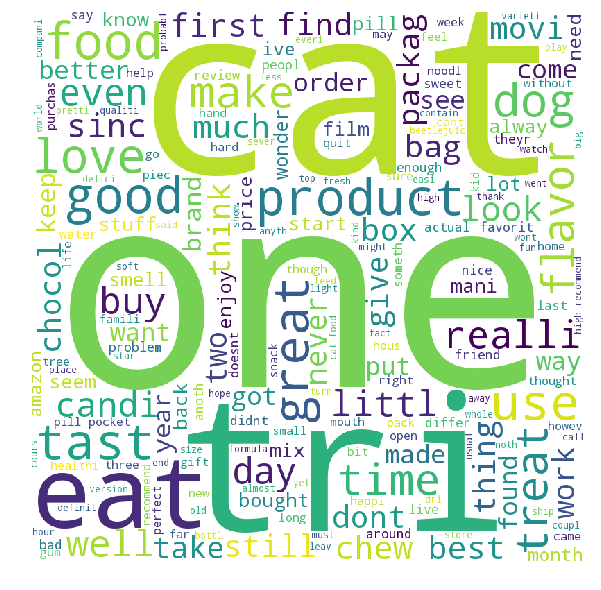

Word cloud for cluster 3


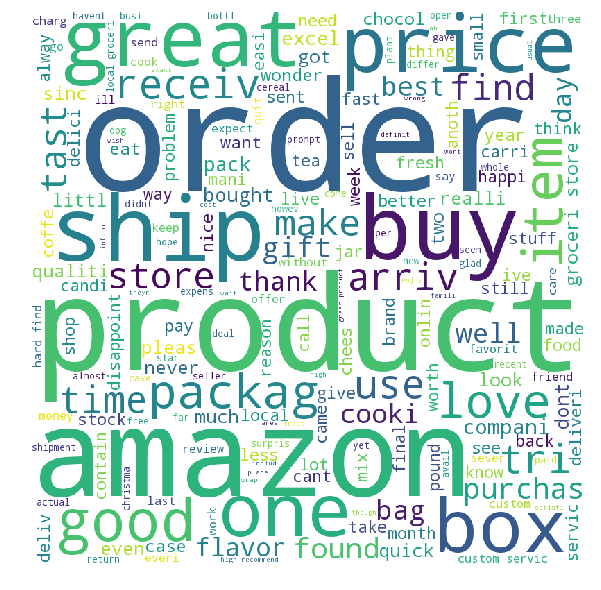

Word cloud for cluster 4


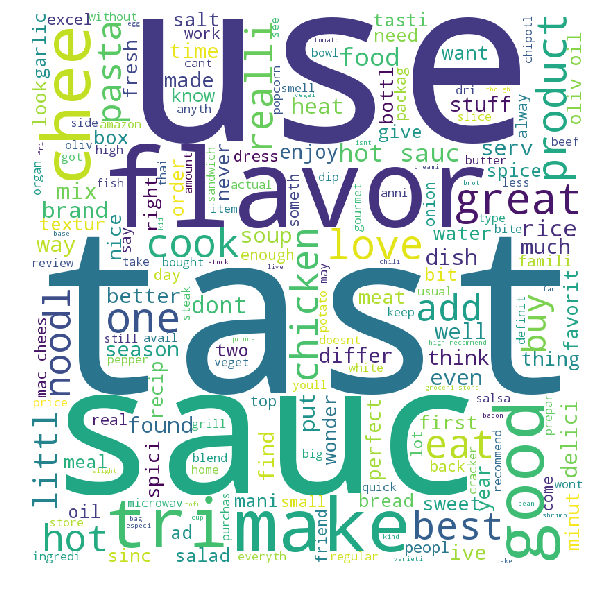

In [0]:

from wordcloud import WordCloud, STOPWORDS 
for j in  range(0,5):
 
  DF = df_[df_['clusters']==j]

  comment_words = ' '
  stopwords = set(STOPWORDS) 

  for val in DF.CleanedText:

	  val = str(val) 

	  tokens = val.split() 

	  for i in range(len(tokens)): 
		  tokens[i] = tokens[i].lower() 
		
	  for words in tokens: 
	    comment_words = comment_words + words + ' '

  print("Word cloud for cluster "+ str(j))
  wordcloud = WordCloud(width = 800, height = 800, background_color ='white', stopwords = stopwords, min_font_size =5,max_words =200).generate(comment_words)
	
  				 
  plt.figure(figsize = (8, 8), facecolor = None) 
  plt.imshow(wordcloud) 
  plt.axis("off") 
  plt.tight_layout(pad = 0) 

  plt.show() 

In [0]:
clf8=AgglomerativeClustering(n_clusters=8)
clf8.fit(X_)



AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='ward', memory=None, n_clusters=8,
            pooling_func=<function mean at 0x7fbb4be1d7b8>)

In [0]:

df_=pd.DataFrame(data,columns=['CleanedText'])
df_['clusters']=clf8.labels_
df_['clusters'].value_counts()

7    932
1    796
3    728
4    696
0    651
5    537
2    334
6    326
Name: clusters, dtype: int64

Word cloud for cluster 0


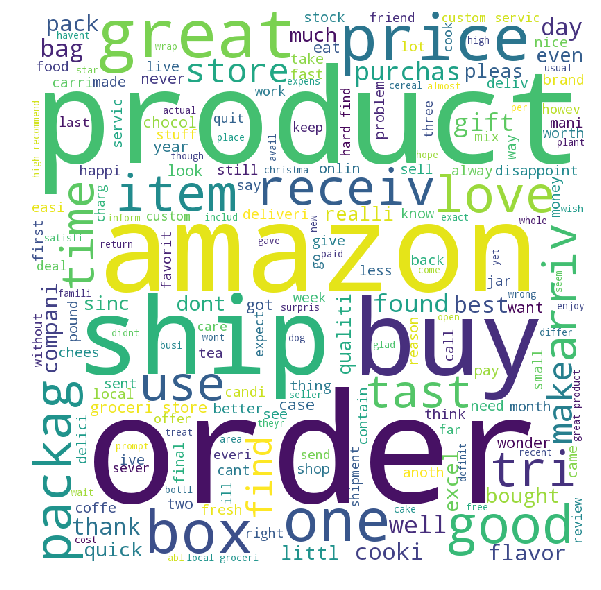

Word cloud for cluster 1


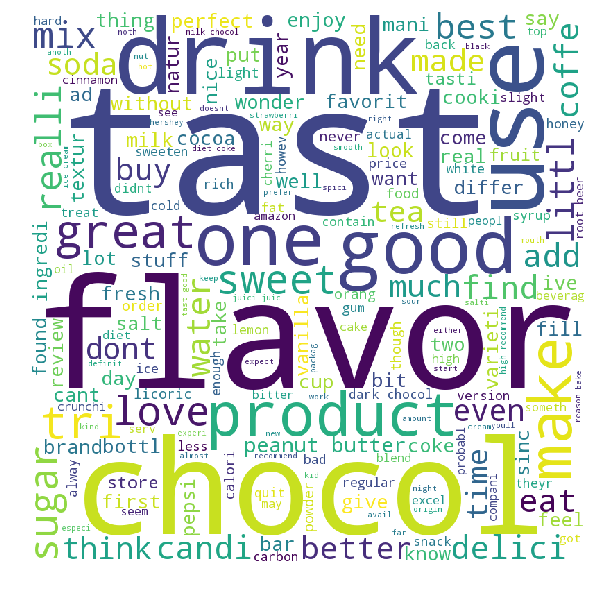

Word cloud for cluster 2


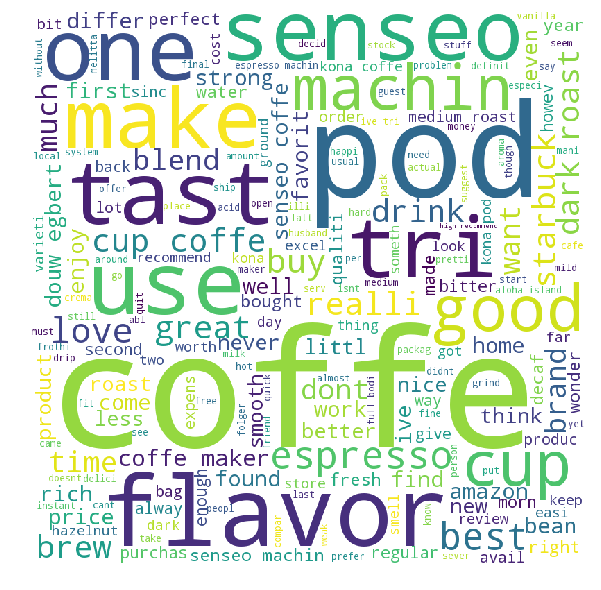

Word cloud for cluster 3


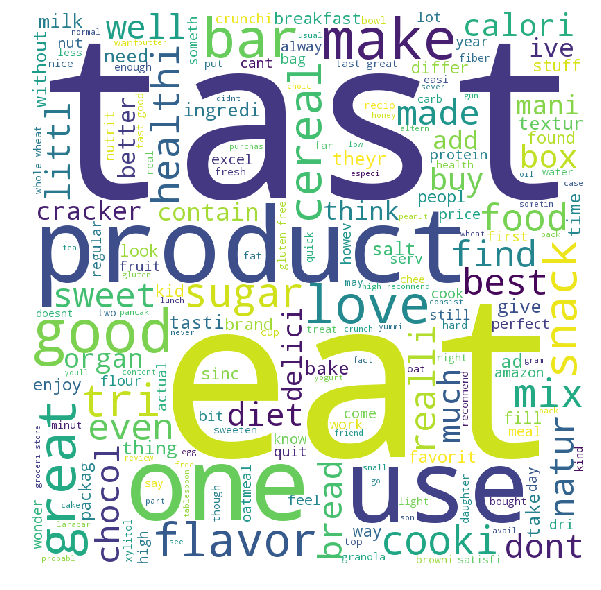

Word cloud for cluster 4


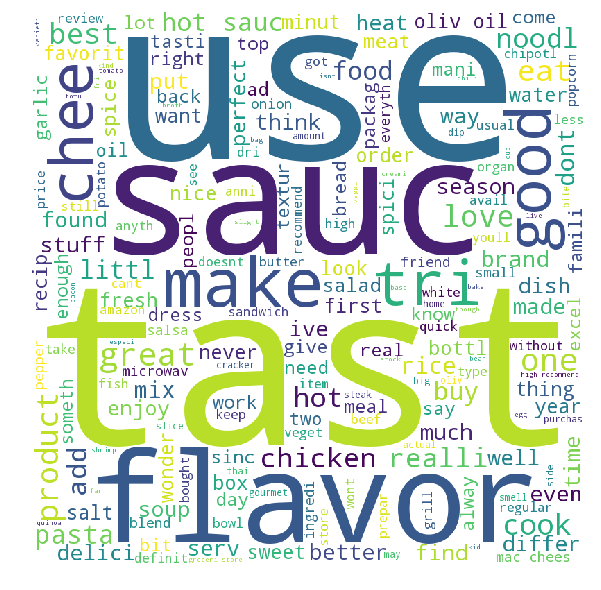

Word cloud for cluster 5


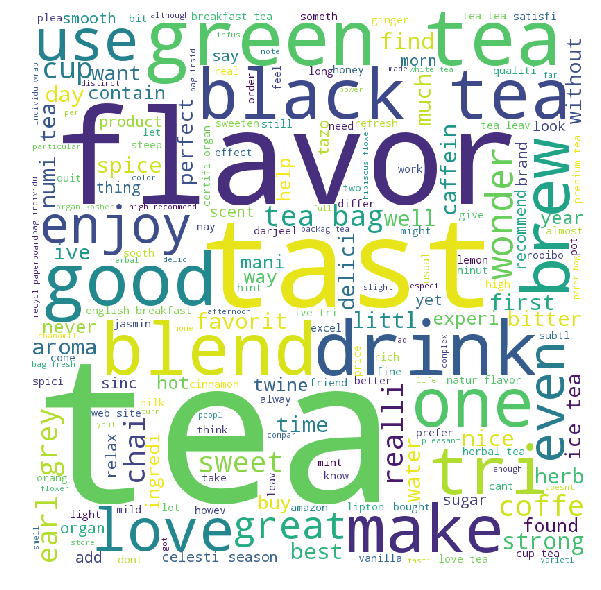

Word cloud for cluster 6


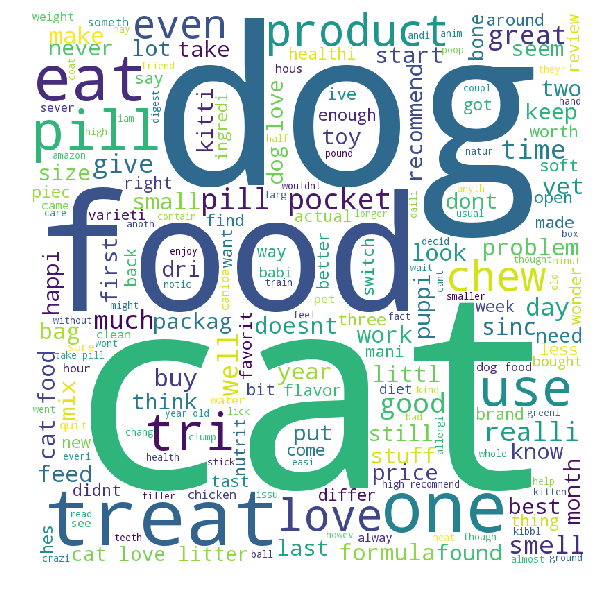

Word cloud for cluster 7


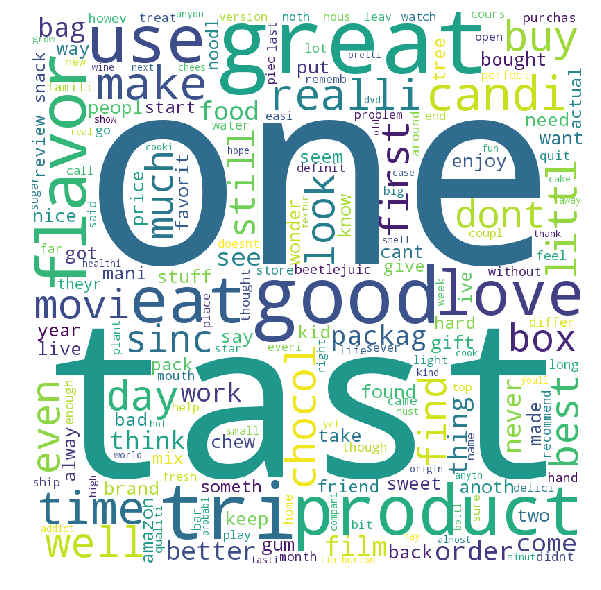

In [0]:

from wordcloud import WordCloud, STOPWORDS 
for j in  range(0,8):
 
  DF = df_[df_['clusters']==j]

  comment_words = ' '
  stopwords = set(STOPWORDS) 

  for val in DF.CleanedText:

	  val = str(val) 

	  tokens = val.split() 

	  for i in range(len(tokens)): 
		  tokens[i] = tokens[i].lower() 
		
	  for words in tokens: 
	    comment_words = comment_words + words + ' '

  print("Word cloud for cluster "+ str(j))
  wordcloud = WordCloud(width = 800, height = 800, background_color ='white', stopwords = stopwords, min_font_size =5,max_words =200).generate(comment_words)
	
  				 
  plt.figure(figsize = (8, 8), facecolor = None) 
  plt.imshow(wordcloud) 
  plt.axis("off") 
  plt.tight_layout(pad = 0) 

  plt.show() 

##DBSCAN

In [0]:
from sklearn.neighbors import NearestNeighbors

In [0]:
nbrs = NearestNeighbors(n_neighbors=50).fit(np.array(sent_vectors))
distances, indices = nbrs.kneighbors(np.array(sent_vectors))

In [0]:
distances.shape

(60000, 200)

In [0]:

opt_dist=distances[:,199]

In [0]:
opt_dist.shape

(60000,)

In [0]:
opt_dist.sort()

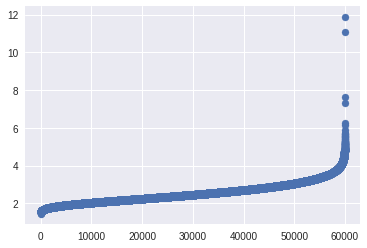

In [0]:
plt.scatter(range(60000),opt_dist)

In [0]:
from sklearn.cluster import DBSCAN

In [0]:
from sklearn.cluster import DBSCAN
dbscan=DBSCAN(eps=4.0,min_samples=200,n_jobs=-1)
dbscan.fit(np.array(sent_vectors)[0:20000,:])

# TF-IDF Word2Vec

In [0]:
tfidf_feat = tf_idf_vect.get_feature_names()

In [0]:
uploads=files.upload()

Saving tfidf_sent to tfidf_sent


In [0]:
test_df=pd.read_pickle('tfidf_sent')

In [0]:
X_=np.array(test_df)

In [0]:
X_.shape

(60000, 50)

In [0]:
tfidf_sent_vectors = []
row=0;
for sent in list_of_sent 
    sent_vec = np.zeros(50)
    weight_sum =0
    for word in sent: 
        if word in w2v_words:
            vec = w2v_model.wv[word]
           
            tf_idf = final_tf_idf[row, tfidf_feat.index(word)]
            sent_vec += (vec * tf_idf)
            weight_sum += tf_idf
    if weight_sum != 0:
        sent_vec /= weight_sum
    tfidf_sent_vectors.append(sent_vec)
    row += 1

In [0]:
X_=np.tfidf_sent_vectors


## K MEANS

10


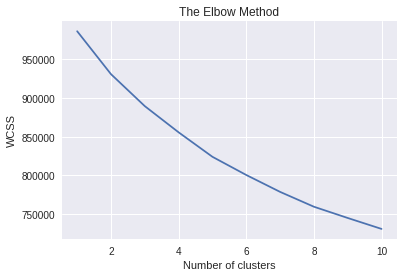

In [0]:
wcss=[]
for i in range(1, 11):
    kmeans = KMeans(n_clusters = i, init ='k-means++', random_state = 0)
    kmeans.fit(X_)
    wcss.append(kmeans.inertia_)
    print(i)
plt.plot(range(1, 11), wcss)
plt.title('The Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()

In [0]:
    kmeans = KMeans(n_clusters = 6, init ='k-means++', random_state = 0)
    kmeans.fit(X)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=6, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=0, tol=0.0001, verbose=0)

In [0]:
len(kmeans.labels_)

60000

In [0]:
train_data=pd.read_pickle("CleanedText")



In [0]:
df.head()

,CleanedText,clusters
138706,witti littl book make son laugh loud recit car...,3
138683,rememb see show air televis year ago child sis...,3
417839,beetlejuic well written movi everyth excel act...,3
346055,twist rumplestiskin captur film star michael k...,3
417838,beetlejuic excel funni movi keaton hilari wack...,3


In [0]:
df=pd.DataFrame(train_data.head(60000))

In [0]:
df['clusters']=kmeans.labels_

Word cloud for cluster 0


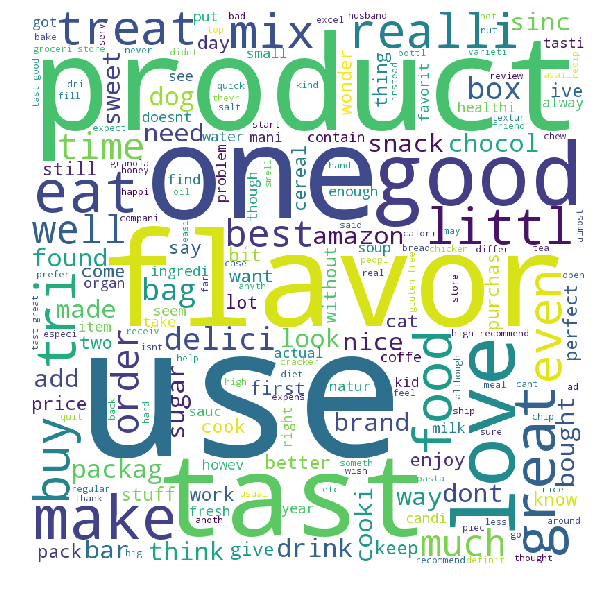

Word cloud for cluster 1


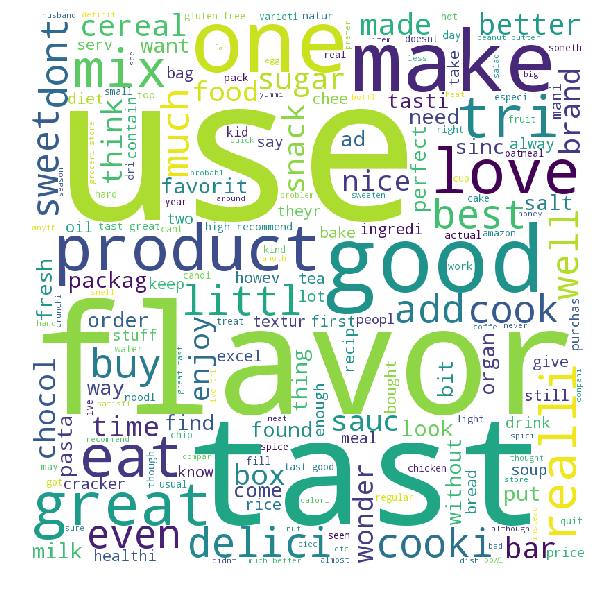

Word cloud for cluster 2


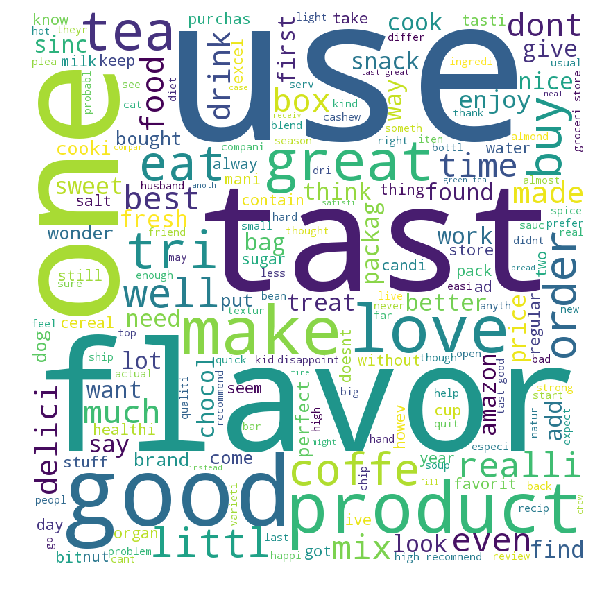

Word cloud for cluster 3


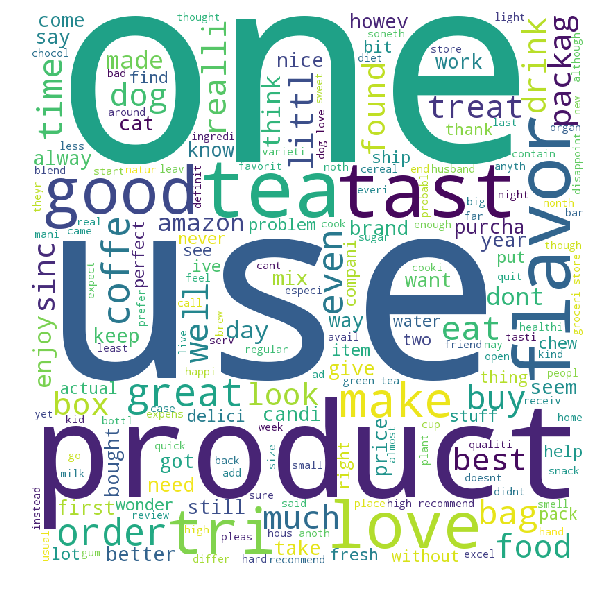

Word cloud for cluster 4


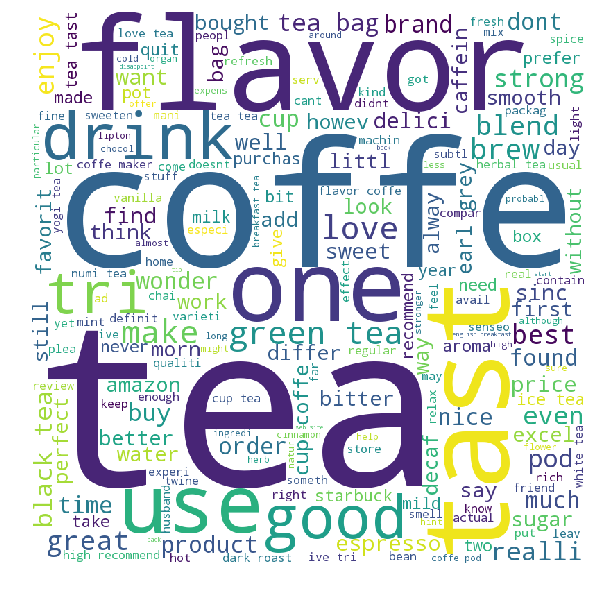

Word cloud for cluster 5


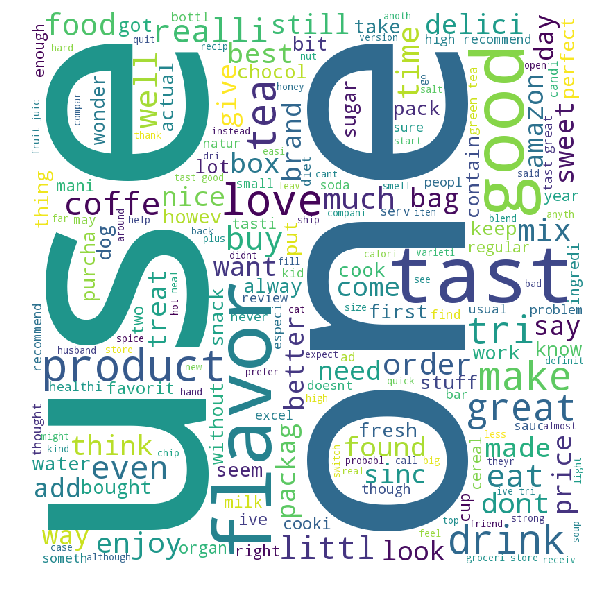

In [0]:

from wordcloud import WordCloud, STOPWORDS 
for j in  range(0,6):
 
  DF = df[df['clusters']==j]

  comment_words = ' '
  stopwords = set(STOPWORDS) 

  for val in DF.CleanedText:

	  val = str(val) 

	  tokens = val.split() 

	  for i in range(len(tokens)): 
		  tokens[i] = tokens[i].lower() 
		
	  for words in tokens: 
	    comment_words = comment_words + words + ' '

  print("Word cloud for cluster "+ str(j))
  wordcloud = WordCloud(width = 800, height = 800, background_color ='white', stopwords = stopwords, min_font_size =5,max_words =200).generate(comment_words)
	
  				 
  plt.figure(figsize = (8, 8), facecolor = None) 
  plt.imshow(wordcloud) 
  plt.axis("off") 
  plt.tight_layout(pad = 0) 

  plt.show() 


##Agglomerative 

In [0]:
tfidf_vectors=pd.read_pickle('tfidf_sent')

In [0]:
new_tfidf_vectors=tfidf_vectors[0:5000]
X0=np.array(new_tfidf_vectors)

In [0]:
X0[0,:]

array([ 0.34179534,  0.40610856,  0.51314575, -0.27369769,  0.43331043,
        0.37256007,  0.11046109,  0.27169211,  0.02576154, -0.68017227,
        0.13450999, -0.57239297, -0.34028356,  0.87924899,  0.27559633,
        0.13713403,  0.26096957, -0.69664589, -0.5217448 , -0.57332733,
        0.3589394 , -0.38336944, -0.43411346,  0.34241232, -0.06207954,
        0.16921656, -0.30941986,  0.29021004,  0.30383112, -0.09418181,
       -0.10210288, -0.24053595, -0.28962569, -0.00806806, -0.21019254,
       -0.16531612,  0.50040702,  0.29074218,  0.11244323,  0.18701311,
        0.16297987, -0.33937976, -0.05957456, -0.12482572, -0.24157898,
        0.29896993,  0.26587611, -0.06443504,  0.48674627, -0.09635173])

In [0]:
clf2=AgglomerativeClustering(n_clusters=2)
clf2.fit(X0)

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='ward', memory=None, n_clusters=2,
            pooling_func=<function mean at 0x7fbb4be1d7b8>)

In [0]:

df_=pd.DataFrame(data,columns=['CleanedText'])
df_['clusters']=clf2.labels_
df_['clusters'].value_counts()


0    4166
1     834
Name: clusters, dtype: int64

Word cloud for cluster 0


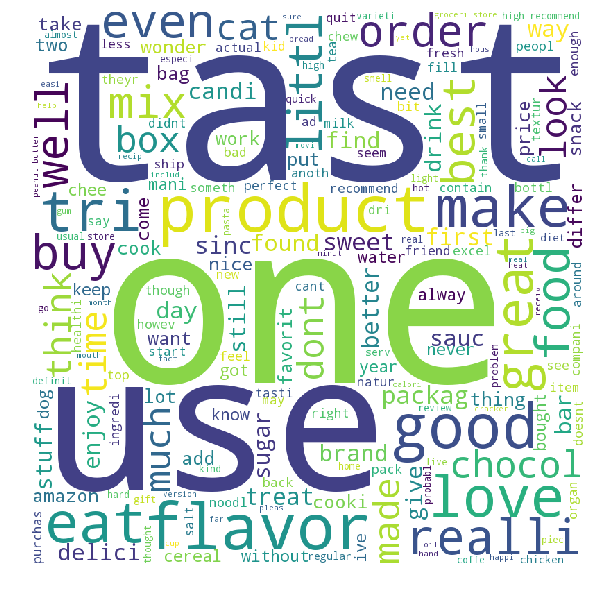

Word cloud for cluster 1


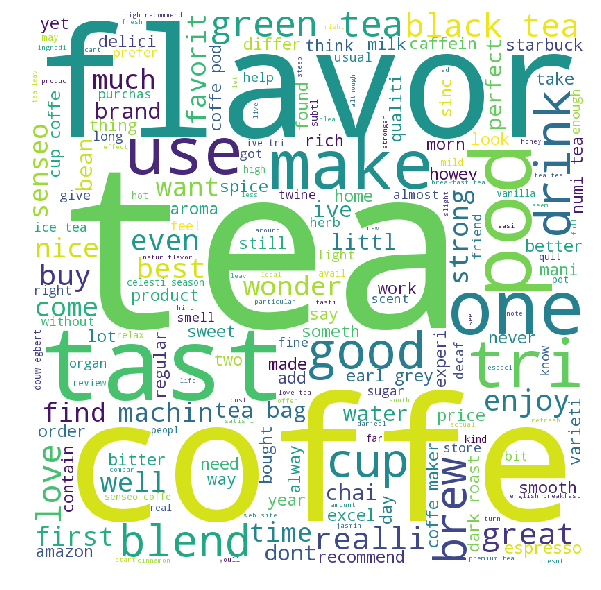

In [0]:


from wordcloud import WordCloud, STOPWORDS 
for j in  range(0,2):
 
  DF = df_[df_['clusters']==j]

  comment_words = ' '
  stopwords = set(STOPWORDS) 

  for val in DF.CleanedText:

	  val = str(val) 

	  tokens = val.split() 

	  for i in range(len(tokens)): 
		  tokens[i] = tokens[i].lower() 
		
	  for words in tokens: 
	    comment_words = comment_words + words + ' '

  print("Word cloud for cluster "+ str(j))
  wordcloud = WordCloud(width = 800, height = 800, background_color ='white', stopwords = stopwords, min_font_size =5,max_words =200).generate(comment_words)
	
  				 
  plt.figure(figsize = (8, 8), facecolor = None) 
  plt.imshow(wordcloud) 
  plt.axis("off") 
  plt.tight_layout(pad = 0) 

  plt.show() 

In [0]:
clf5=AgglomerativeClustering(n_clusters=5)
clf5.fit(X0)

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='ward', memory=None, n_clusters=5,
            pooling_func=<function mean at 0x7fbb4be1d7b8>)

In [0]:

df_=pd.DataFrame(data,columns=['CleanedText'])
df_['clusters']=clf5.labels_
df_['clusters'].value_counts()


0    2996
4     819
1     480
3     354
2     351
Name: clusters, dtype: int64

Word cloud for cluster 0


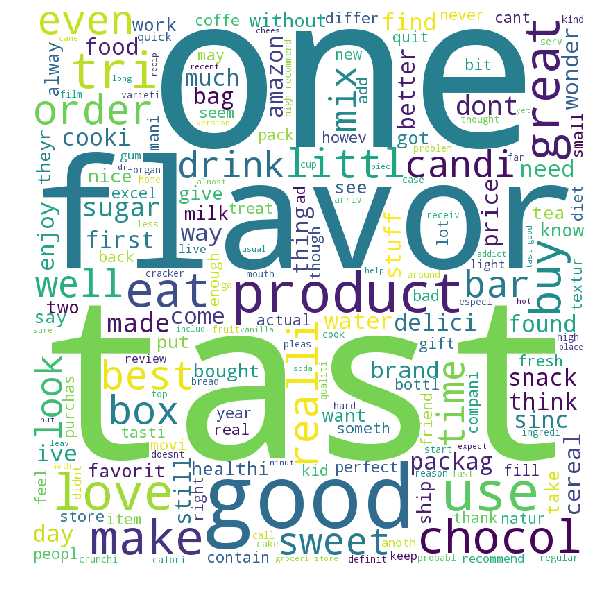

Word cloud for cluster 1


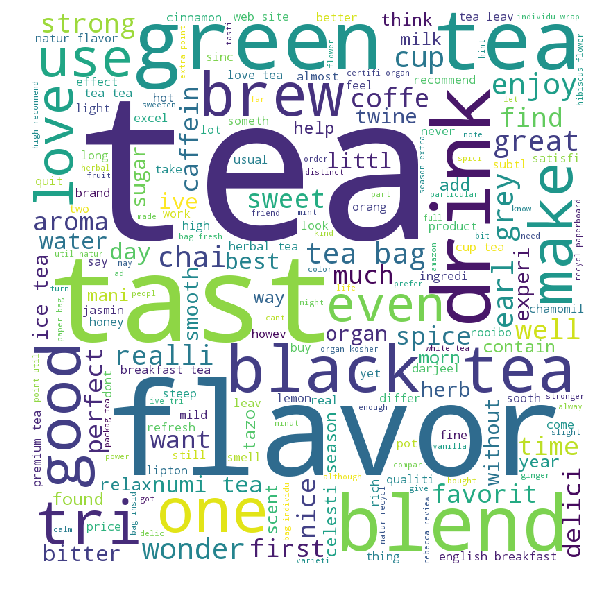

Word cloud for cluster 2


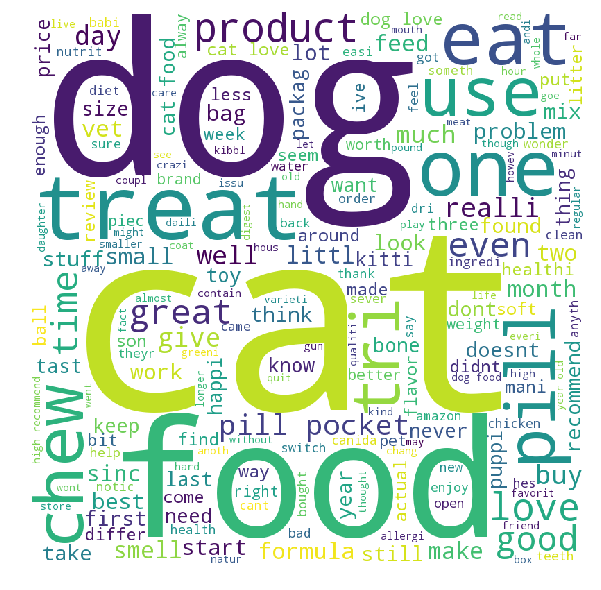

Word cloud for cluster 3


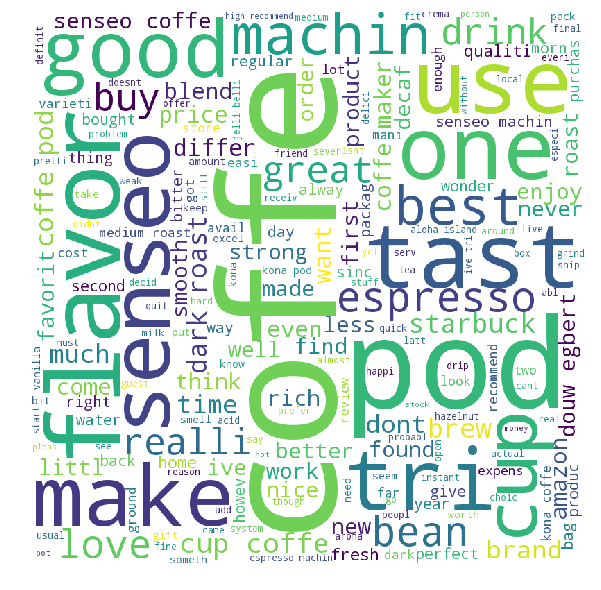

Word cloud for cluster 4


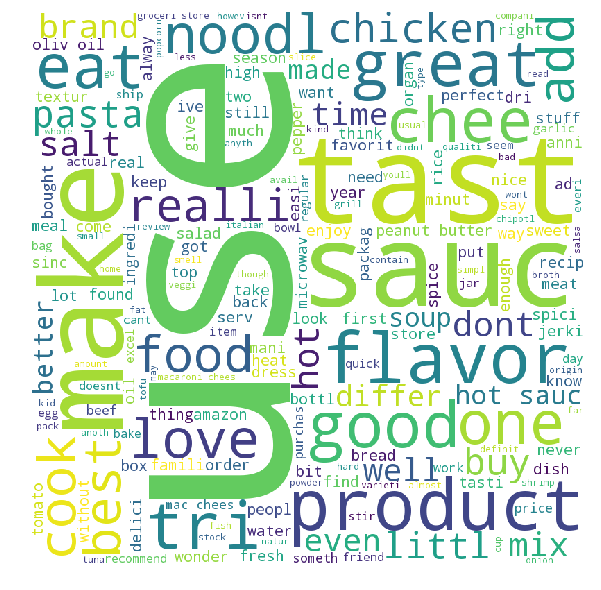

In [0]:


from wordcloud import WordCloud, STOPWORDS 
for j in  range(0,5):
 
  DF = df_[df_['clusters']==j]

  comment_words = ' '
  stopwords = set(STOPWORDS) 

  for val in DF.CleanedText:

	  val = str(val) 

	  tokens = val.split() 

	  for i in range(len(tokens)): 
		  tokens[i] = tokens[i].lower() 
		
	  for words in tokens: 
	    comment_words = comment_words + words + ' '

  print("Word cloud for cluster "+ str(j))
  wordcloud = WordCloud(width = 800, height = 800, background_color ='white', stopwords = stopwords, min_font_size =5,max_words =200).generate(comment_words)
	
  				 
  plt.figure(figsize = (8, 8), facecolor = None) 
  plt.imshow(wordcloud) 
  plt.axis("off") 
  plt.tight_layout(pad = 0) 

  plt.show() 

In [0]:
clf8=AgglomerativeClustering(n_clusters=8)
clf8.fit(X0)

AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
            connectivity=None, linkage='ward', memory=None, n_clusters=8,
            pooling_func=<function mean at 0x7fbb4be1d7b8>)

In [0]:

df_=pd.DataFrame(data,columns=['CleanedText'])
df_['clusters']=clf8.labels_
df_['clusters'].value_counts()


0    1607
1     819
2     740
6     649
3     354
5     351
7     283
4     197
Name: clusters, dtype: int64

Word cloud for cluster 0


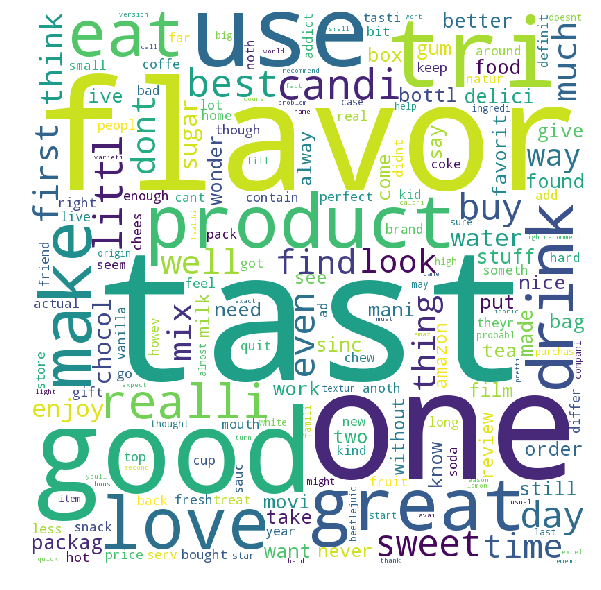

Word cloud for cluster 1


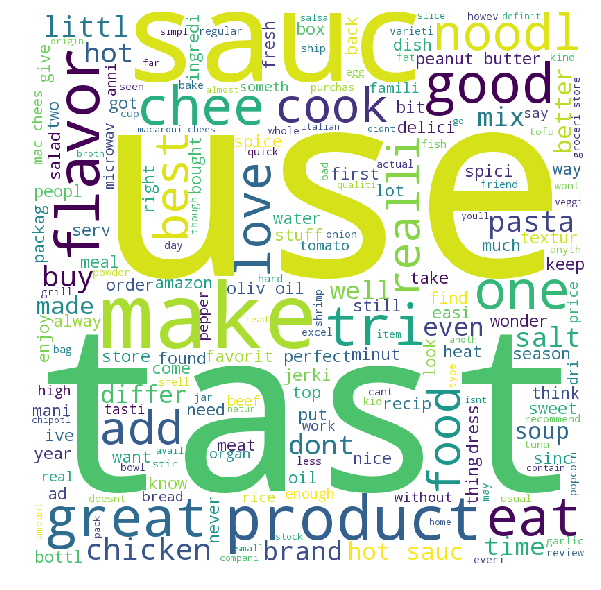

Word cloud for cluster 2


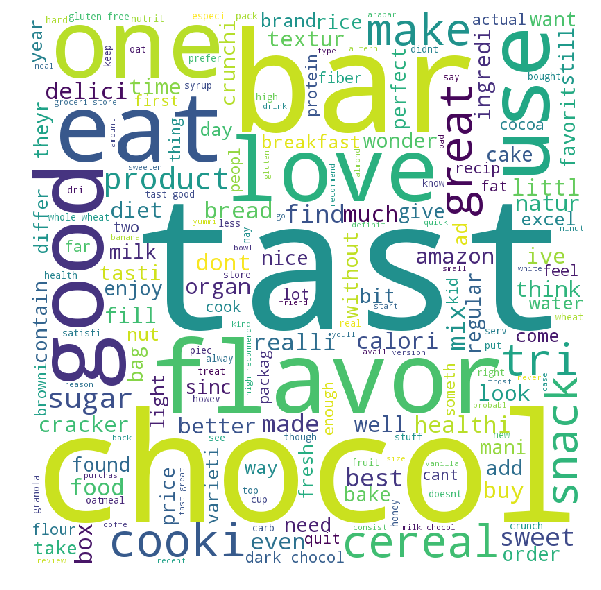

Word cloud for cluster 3


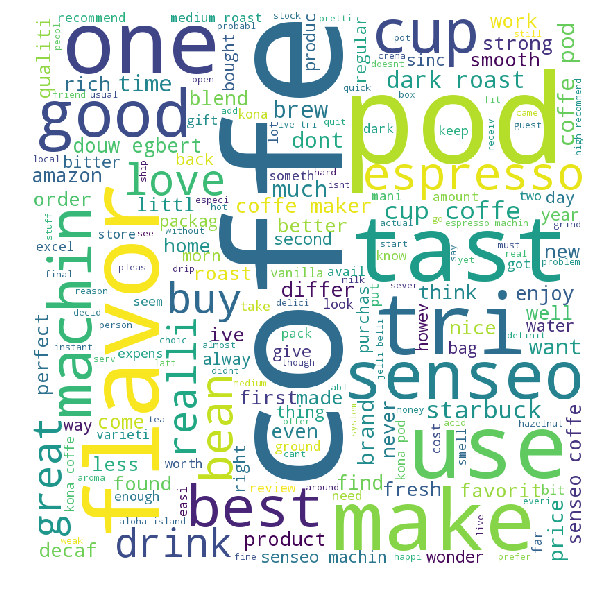

Word cloud for cluster 4


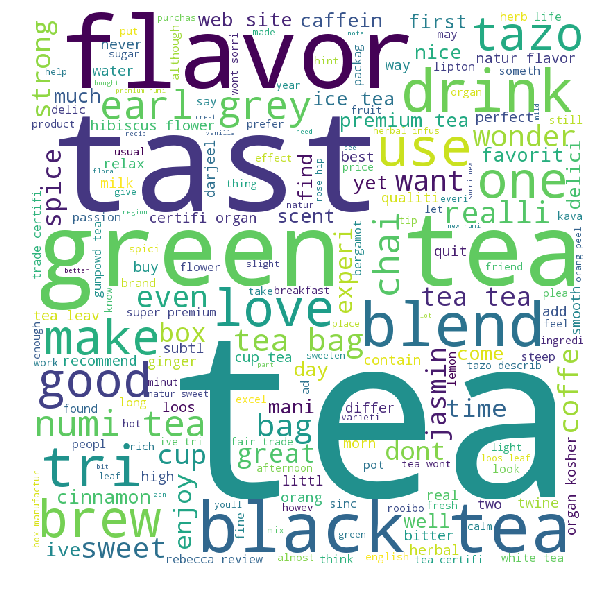

Word cloud for cluster 5


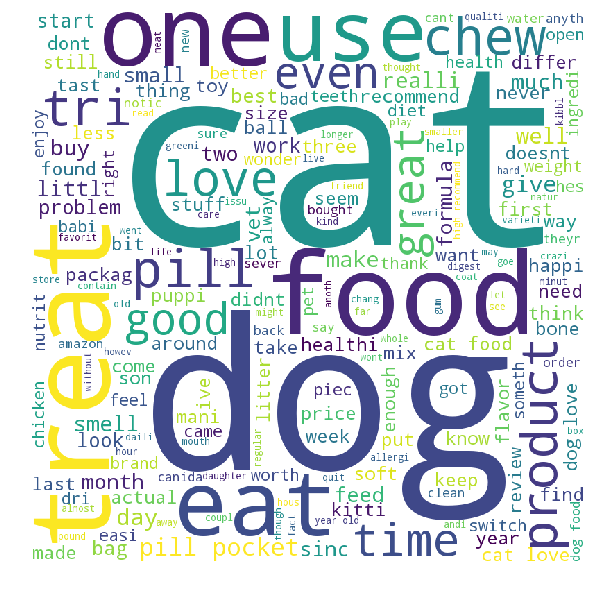

Word cloud for cluster 6


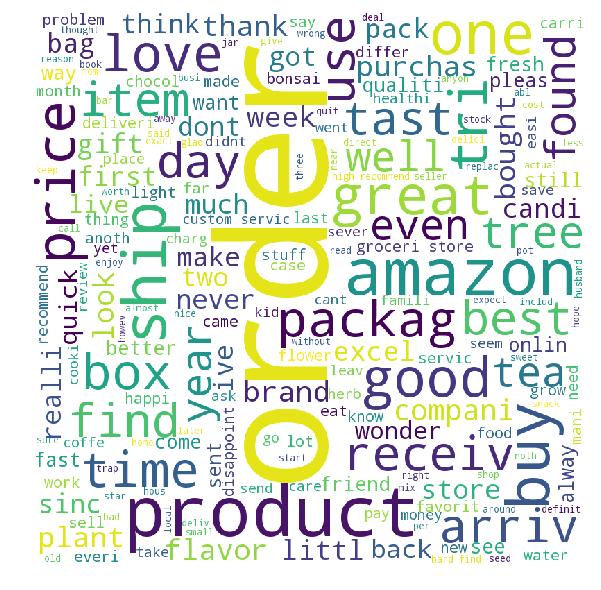

Word cloud for cluster 7


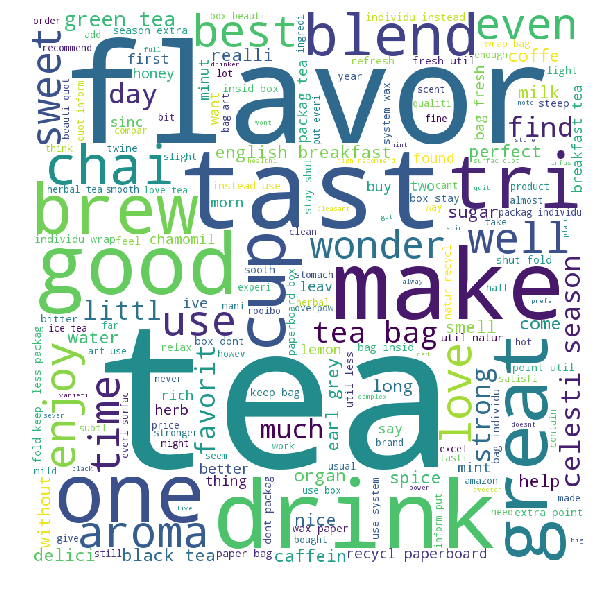

In [0]:


from wordcloud import WordCloud, STOPWORDS 
for j in  range(0,8):
 
  DF = df_[df_['clusters']==j]

  comment_words = ' '
  stopwords = set(STOPWORDS) 

  for val in DF.CleanedText:

	  val = str(val) 

	  tokens = val.split() 

	  for i in range(len(tokens)): 
		  tokens[i] = tokens[i].lower() 
		
	  for words in tokens: 
	    comment_words = comment_words + words + ' '

  print("Word cloud for cluster "+ str(j))
  wordcloud = WordCloud(width = 800, height = 800, background_color ='white', stopwords = stopwords, min_font_size =5,max_words =200).generate(comment_words)
	
  				 
  plt.figure(figsize = (8, 8), facecolor = None) 
  plt.imshow(wordcloud) 
  plt.axis("off") 
  plt.tight_layout(pad = 0) 

  plt.show() 

##DBSCAN

In [0]:

from sklearn.neighbors import NearestNeighbors
nbrs = NearestNeighbors(n_neighbors=100).fit(np.array(X_))
distances, indices = nbrs.kneighbors(np.array(X_))

In [0]:
distances.shape


(60000, 100)

In [0]:
opt_dist=distances[:,99]

In [0]:
opt_dist.sort()

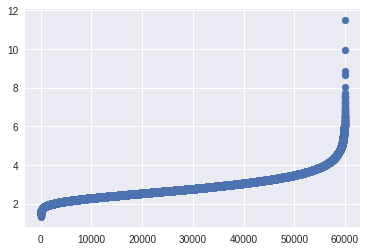

In [0]:
plt.scatter(range(60000),opt_dist)

In [0]:
from sklearn.cluster import DBSCAN
dbscan=DBSCAN(eps=4.2,min_samples=100,n_jobs=-1)
dbscan.fit(np.array(X_))

DBSCAN(algorithm='auto', eps=4.2, leaf_size=30, metric='euclidean',
    metric_params=None, min_samples=100, n_jobs=-1, p=None)

In [0]:
df=pd.DataFrame(train_data)

In [0]:
df['cluster']=dbscan.labels_

In [0]:
df['cluster'].value_counts()

 0    59956
-1       44
Name: cluster, dtype: int64

In [0]:
!pip install wordcloud

In [0]:

from wordcloud import WordCloud, STOPWORDS 
for j in  range(0,2):
 
  DF = df[df['cluster']==j]

  comment_words = ' '
  stopwords = set(STOPWORDS) 

  for val in DF.CleanedText:

	  val = str(val) 

	  tokens = val.split() 

	  for i in range(len(tokens)): 
		  tokens[i] = tokens[i].lower() 
		
	  for words in tokens: 
	    comment_words = comment_words + words + ' '

  print("Word cloud for cluster "+ str(j))
  wordcloud = WordCloud(width = 800, height = 800, background_color ='white', stopwords = stopwords, min_font_size =5,max_words =200).generate(comment_words)
	
  				 
  plt.figure(figsize = (8, 8), facecolor = None) 
  plt.imshow(wordcloud) 
  plt.axis("off") 
  plt.tight_layout(pad = 0) 

  plt.show() 


Word cloud for cluster -1


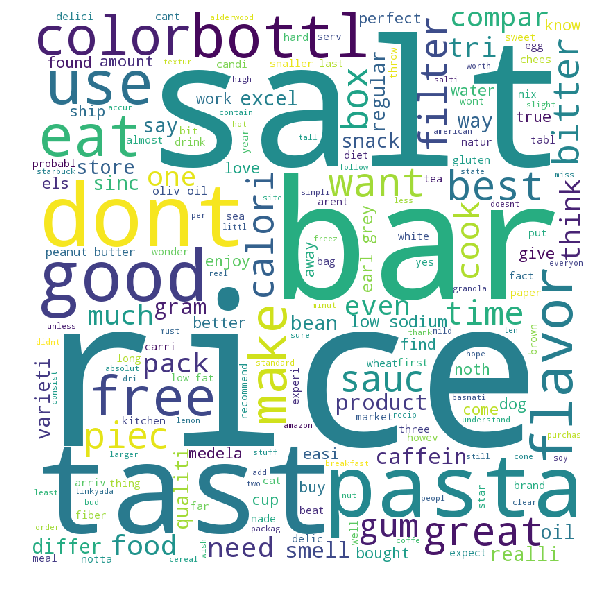

In [0]:
  DF = df[df['cluster']==-1]

  comment_words = ' '
  stopwords = set(STOPWORDS) 

  for val in DF.CleanedText:

	  val = str(val) 

	  tokens = val.split() 

	  for i in range(len(tokens)): 
		  tokens[i] = tokens[i].lower() 
		
	  for words in tokens: 
	    comment_words = comment_words + words + ' '

  print("Word cloud for cluster "+ str(-1))
  wordcloud = WordCloud(width = 800, height = 800, background_color ='white', stopwords = stopwords, min_font_size =5,max_words =200).generate(comment_words)
	
  				 
  plt.figure(figsize = (8, 8), facecolor = None) 
  plt.imshow(wordcloud) 
  plt.axis("off") 
  plt.tight_layout(pad = 0) 

  plt.show()

In [0]:
from sklearn.cluster import DBSCAN


In [0]:
from sklearn.cluster import DBSCAN
dbscan=DBSCAN(eps=4.3,min_samples=100,n_jobs=-1)
dbscan.fit(np.array(X_))

DBSCAN(algorithm='auto', eps=4.3, leaf_size=30, metric='euclidean',
    metric_params=None, min_samples=100, n_jobs=-1, p=None)

In [0]:
df2=pd.DataFrame(train_data)

In [0]:
df2['clusters']=dbscan.labels_

In [0]:
df2['clusters'].value_counts()

 0    59970
-1       30
Name: clusters, dtype: int64

In [0]:
dbscan2=DBSCAN(eps=4.5,min_samples=100,n_jobs=-1)
dbscan2.fit(np.array(X_))

DBSCAN(algorithm='auto', eps=4.5, leaf_size=30, metric='euclidean',
    metric_params=None, min_samples=100, n_jobs=-1, p=None)

In [0]:
data=pd.read_pickle('CleanedText')

In [0]:
train_data=data.head(60000)

In [0]:
df3=pd.DataFrame(train_data)

In [0]:
df3['clusters']=dbscan2.labels_

In [0]:
df3['clusters'].value_counts()

 0    59987
-1       13
Name: clusters, dtype: int64

In [0]:
!pip install wordcloud

    100% |████████████████████████████████| 368kB 8.4MB/s 


In [0]:
df3=pd.read_pickle('df3')

Word cloud for cluster 0


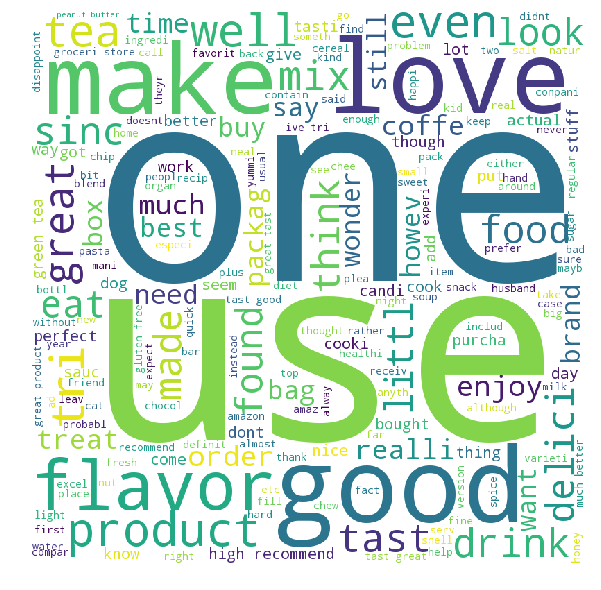

In [0]:


from wordcloud import WordCloud, STOPWORDS 
for j in  range(0,1):
 
  DF = df3[df3['clusters']==j]

  comment_words = ' '
  stopwords = set(STOPWORDS) 

  for val in DF.CleanedText:

	  val = str(val) 

	  tokens = val.split() 

	  for i in range(len(tokens)): 
		  tokens[i] = tokens[i].lower() 
		
	  for words in tokens: 
	    comment_words = comment_words + words + ' '

  print("Word cloud for cluster "+ str(j))
  wordcloud = WordCloud(width = 800, height = 800, background_color ='white', stopwords = stopwords, min_font_size =5,max_words =200).generate(comment_words)
	
  				 
  plt.figure(figsize = (8, 8), facecolor = None) 
  plt.imshow(wordcloud) 
  plt.axis("off") 
  plt.tight_layout(pad = 0) 

  plt.show() 

#Conclusion

In [0]:
!pip install prettytable
from prettytable import PrettyTable

In [0]:
x = PrettyTable()

x.field_names = ["Model", "Depth","Train ACC( F1_score)", "Test ACC"]

x.add_row(["Bag of words",6,87.6, 87.4])
x.add_row(["TF_IDF",11 ,88.07, 88.1])
x.add_row(["AVG-W2VEC",20,89.23, 88.38])
x.add_row([" Weighted TF_IDF",30,83.76, 81.33])
print(x)

+------------------+-------+----------------------+----------+
|      Model       | Depth | Train ACC( F1_score) | Test ACC |
+------------------+-------+----------------------+----------+
|   Bag of words   |   6   |         87.6         |   87.4   |
|      TF_IDF      |   11  |        88.07         |   88.1   |
|    AVG-W2VEC     |   20  |        89.23         |  88.38   |
|  Weighted TF_IDF |   30  |        83.76         |  81.33   |
+------------------+-------+----------------------+----------+
